In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable


from ipywidgets import interact, fixed
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from matplotlib.patches import Ellipse
from scipy import linalg

#import plotly.express as px
import urllib.request
import zipfile
from matplotlib.colors import ListedColormap
import matplotlib.colors as mcolors
from matplotlib.ticker import FuncFormatter
from sklearn.decomposition import PCA, FactorAnalysis
from factor_analyzer import FactorAnalyzer, calculate_kmo, calculate_bartlett_sphericity
from sklearn.preprocessing import StandardScaler
from factor_analyzer import FactorAnalyzer

import os
# os.environ["OMP_NUM_THREADS"] = "2"

from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV

from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, mean_absolute_percentage_error, mean_squared_error

import pandas as pd
import ast
import numpy as np
from pathlib import Path  
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import geopandas as gpd
import pandas as pd
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D
import seaborn as sns
import matplotlib.pyplot as plt
from adjustText import adjust_text
from matplotlib.patches import Patch
from sklearn.decomposition import PCA, FactorAnalysis
import matplotlib.colors as mcolors
from matplotlib.ticker import FuncFormatter


import warnings
warnings.filterwarnings("ignore", message="KMeans is known to have a memory leak")


C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


In [2]:
msa_emissions = pd.read_csv('../../data/tidy/grouped-msa-total.csv') # modeshares (for commuting)
factors = pd.read_csv('../../data/tidy/factors-factoranalysis.csv') # modeshares (for commuting)
factors_df = pd.read_csv('../../data/tidy/raw-data-cleaned.csv')
raw = pd.read_csv('../../data/tidy/raw-data-cluster.csv')

In [3]:
msa_emissions

,MSA,carbon dioxide equivalent (Ton)
0,"Abilene, TX",1.604661e+06
1,"Akron, OH",4.038062e+06
2,"Albany, GA",1.062811e+06
3,"Albany-Lebanon, OR",9.640033e+05
4,"Albany-Schenectady-Troy, NY",4.416599e+06
...,...,...
373,"Yakima, WA",1.345779e+06
374,"York-Hanover, PA",2.087107e+06
375,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06
376,"Yuba City, CA",5.800871e+05


In [4]:
raw

,msa,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),Street segment count,...,Electric Propulsion (kwh),Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km),Cluster
0,"Abilene, TX",14357.0,39401.0,5.488751,17168.965935,0.435749,2.881452,11912.0,8925.436120,20606.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,24.019917,4
1,"Akron, OH",26865.0,70900.0,5.278243,15191.985931,0.214273,2.756896,21200.0,8039.294972,36980.0,...,0.0,0.0,2619706.0,560570.0,3166425.0,0.0,0.0,0.0,294.018910,5
2,"Albany, GA",8466.0,22838.0,5.395228,9545.102272,0.417948,2.837468,6957.0,4989.592979,11954.0,...,0.0,0.0,148053.0,12499.0,439611.0,0.0,0.0,0.0,35.333378,4
3,"Albany-Lebanon, OR",7132.0,17906.0,5.021312,8280.294430,0.462431,2.568144,5101.0,4225.438910,9147.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,21.285743,4
4,"Albany-Schenectady-Troy, NY",36977.0,96867.0,5.239311,27872.441864,0.287739,2.755794,30254.0,14555.424691,50900.0,...,0.0,42126.0,8632669.0,1343264.0,0.0,0.0,0.0,0.0,118.206895,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",10920.0,28902.0,5.293407,14155.026874,0.489759,2.709982,8275.0,7249.500452,14773.0,...,0.0,0.0,730634.0,275527.0,0.0,0.0,0.0,0.0,22.459825,1
351,"York-Hanover, PA",16622.0,44476.0,5.351462,13291.255851,0.298841,2.781194,13507.0,6831.204674,23064.0,...,0.0,0.0,515734.0,6299147.0,553503.0,0.0,0.0,0.0,189.847748,1
352,"Youngstown-Warren-Boardman, OH-PA",24885.0,66650.0,5.356641,19738.540791,0.296152,2.794736,19982.0,10381.621775,34674.0,...,0.0,0.0,1467533.0,486469.0,0.0,0.0,0.0,0.0,119.182102,5
353,"Yuba City, CA",8419.0,21665.0,5.146692,7925.868395,0.365837,2.678465,6360.0,4094.273240,11260.0,...,0.0,0.0,926082.0,0.0,0.0,0.0,0.0,0.0,53.631459,4


In [5]:
# Assume df is your DataFrame
# Step 1: Separate the 'msa' and 'cluster' columns
msa_cluster = raw[['msa', 'Cluster']]
data_to_standardize = raw.drop(columns=['msa', 'Cluster'])

# Step 2: Standardize the remaining columns
scaler = StandardScaler()
standardized_data = scaler.fit_transform(data_to_standardize)

# Step 3: Create a new DataFrame with the standardized data
standardized_df = pd.DataFrame(standardized_data, columns=data_to_standardize.columns)

# Step 4: Add the 'msa' and 'cluster' columns back
raw = pd.concat([msa_cluster, standardized_df], axis=1)

In [6]:
raw

,msa,Cluster,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),...,Other Fuel (gal/gal equivalent),Electric Propulsion (kwh),Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km)
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.097156,-0.097615,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.097156,-0.097615,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.097156,-0.097615,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.097156,-0.097615,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.097156,-0.097615,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.097156,-0.097615,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.097156,-0.097615,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.097156,-0.097615,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.097156,-0.097615,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031


In [7]:
extracted_df = factors_df[['msa', 'Total population']]
extracted_df

,msa,Total population
0,"Abilene, TX",171354
1,"Akron, OH",703286
2,"Albany, GA",147431
3,"Albany-Lebanon, OR",127216
4,"Albany-Schenectady-Troy, NY",880766
...,...,...
350,"Yakima, WA",250649
351,"York-Hanover, PA",447628
352,"Youngstown-Warren-Boardman, OH-PA",538115
353,"Yuba City, CA",173839


In [8]:
last_column_name = factors.columns[-1]

factors[last_column_name] = factors[last_column_name].astype('category')


In [9]:
#predicting emissions using random forest

In [10]:
# Standardize column names for merging
factors.rename(columns={'msa': 'MSA'}, inplace=True)

# Merge data on the 'MSA' column
data = pd.merge(msa_emissions, factors, on='MSA')

In [11]:
data

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,4
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,5
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,4
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,4
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,5
...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,1
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,1
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,5
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,4


In [12]:
# Merge DataFrames on the columns 'msa' and 'MSA'
merged_df = pd.merge(data, extracted_df, left_on='MSA', right_on='msa')

# Drop the duplicate 'MSA' column if needed
merged_df = merged_df.drop(columns=['msa'])

merged_df

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Total population
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,4,171354
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,5,703286
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,4,147431
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,4,127216
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,5,880766
...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,1,250649
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,1,447628
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,5,538115
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,4,173839


In [13]:
merged_df['Emissions per capita']=merged_df['carbon dioxide equivalent (Ton)']/merged_df['Total population']
merged_df['carbon dioxide equivalent (MMTCO2e)']=merged_df['carbon dioxide equivalent (Ton)']/1102311.31

In [14]:
merged_df

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Total population,Emissions per capita,carbon dioxide equivalent (MMTCO2e)
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,4,171354,9.364594,1.455724
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,5,703286,5.741707,3.663268
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,4,147431,7.208870,0.964166
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,4,127216,7.577689,0.874529
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,5,880766,5.014498,4.006672
...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,1,250649,5.369176,1.220870
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,1,447628,4.662592,1.893391
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,5,538115,5.741362,2.802759
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,4,173839,3.336922,0.526246


In [15]:
raw['Emissions per capita']=merged_df['Emissions per capita']
raw['carbon dioxide equivalent (MMTCO2e)']=merged_df['carbon dioxide equivalent (MMTCO2e)']

In [16]:
raw

,msa,Cluster,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),...,Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km),Emissions per capita,carbon dioxide equivalent (MMTCO2e)
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731,9.364594,1.455724
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119,5.741707,3.663268
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396,7.208870,0.964166
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188,7.577689,0.874529
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205,5.014498,4.006672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257,5.369176,1.220870
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224,4.662592,1.893391
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285,5.741362,2.802759
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031,3.336922,0.526246


In [17]:
raw.columns

raw = raw.rename(columns={
    'Street length total (km)': 'Street Length (km)',
    'Intersection density (per sq km)': 'Intersection Density (per sq km)',
    'Street density (km/sq km)': 'Street Density (km/sq km)',
    'Building area (sq km)': 'Building Area (sq km)',
    'Median Income': 'Median Income ($)',
    'Total population': 'Population',
    'Total housing units': 'Housing Units',
    '1 vehicle available': '1 Vehicle Available',
    '2 vehicle available': '2 Vehicle Available',
    '3 or more vehicle available': '3 or More Vehicle Available',
    'No vehicle available': 'No Vehicle Available',
    'GDP': 'GDP ($)',
    'Population density (people/sq km)': 'Population Density (people/sq km)',
    'Car, truck, or van:': 'Personal Vehicle (mode share %)',
    'Public transportation (excluding taxicab):':'Public Transportation (mode share %)',
    'Bicycle':'Bicycle (mode share %)',
    'Walked':'Walked (mode share %)',
    'Worked from home':'Worked from Home (mode share %)',
    'Employment Rate':'Employment Rate (%)',
    'Unemployment Rate':'Unemployment Rate (%)',
    'Liquefied Petroleum Gas (gal equivalent)':'Liquefied Petroleum Gas (GGE)',
    'Compressed Natural Gas (gal equivalent)':'Compressed Natural Gas (GGE)',
    'Other Fuel (gal/gal equivalent)':'Other Fuel (GGE)',
    'Node count':'Node Count',
    'Edge count':'Edge Count',
    'Degree average':'Degree Average',
    'Edge length total (km)':'Edge Length Total (km)',
    'Edge length average (km)':'Edge Length Average (km)',
    'Streets per node average':'Streets per Node Average',
    'Intersection count':'Intersection Count',
    'Street length total (km)':'Street Length Total (km)',
    'Street segment count':'Street Segment Count',
    'Street length average (km)':'Street Length Average (km)',
    'Circuity average':'Circuity Average',
    'Self-loop proportion':'Self-loop Proportion',
    'Node density (per sq km)':'Node Density (per sq km)',
    'Intersection density (per sq km)':'Intersection Density (per sq km)',
    'Edge density (km/sq km)':'Edge Density (km/sq km)',
    'Street density (km/sq km)':'Street Density (km/sq km)',
    'Building area (sq km)':'Building Area (sq km)'
})

In [18]:
raw

,msa,Cluster,Node Count,Edge Count,Degree Average,Edge Length Total (km),Edge Length Average (km),Streets per Node Average,Intersection Count,Street Length Total (km),...,Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population Density (people/sq km),Emissions per capita,carbon dioxide equivalent (MMTCO2e)
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731,9.364594,1.455724
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119,5.741707,3.663268
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396,7.208870,0.964166
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188,7.577689,0.874529
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205,5.014498,4.006672
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257,5.369176,1.220870
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224,4.662592,1.893391
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285,5.741362,2.802759
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031,3.336922,0.526246


In [19]:
raw.columns

Index(['msa', 'Cluster', 'Node Count', 'Edge Count', 'Degree Average',
       'Edge Length Total (km)', 'Edge Length Average (km)',
       'Streets per Node Average', 'Intersection Count',
       'Street Length Total (km)', 'Street Segment Count',
       'Street Length Average (km)', 'Circuity Average',
       'Self-loop Proportion', 'Node Density (per sq km)',
       'Intersection Density (per sq km)', 'Edge Density (km/sq km)',
       'Street Density (km/sq km)', 'Building Area (sq km)', 'Area (sq km)',
       'Personal Vehicle (mode share %)',
       'Public Transportation (mode share %)', 'Bicycle (mode share %)',
       'Walked (mode share %)', 'Worked from Home (mode share %)',
       'Median Income ($)', 'Employment Rate (%)', 'Unemployment Rate (%)',
       'Population', 'Housing Units', 'No vehicles available',
       '1 Vehicle Available', '2 vehicles available',
       '3 or more vehicles available', 'GDP ($)', 'Diesel (gal)',
       'Gasoline (gal)', 'Liquefied Petroleum Ga

Unique Clusters in DataFrame: {1, 2, 3, 4, 5, 6, 7}
Cluster Colors Dictionary Keys: {1, 2, 3, 4, 5, 6, 7}


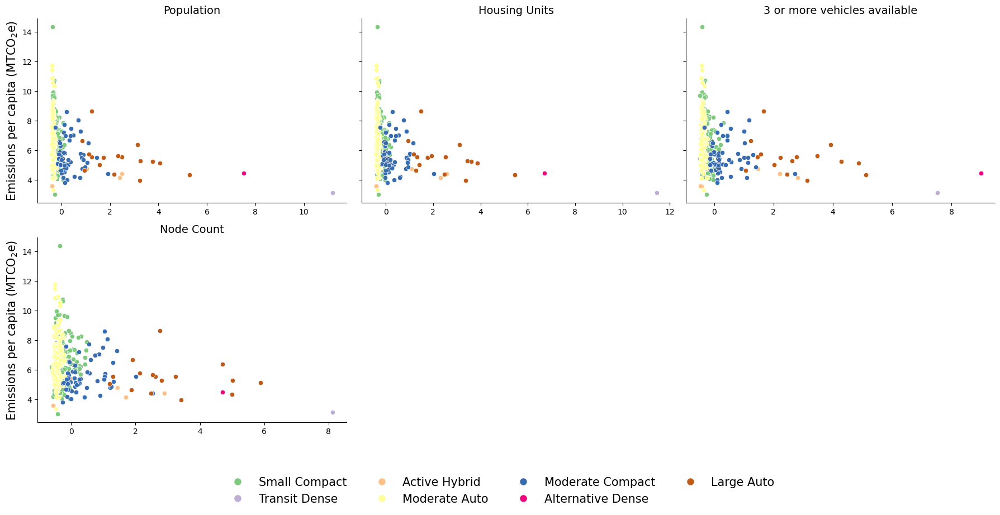

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the list of columns you want to plot against 'Emissions per capita'
columns_to_plot = ['Population','Housing Units', '3 or more vehicles available','Node Count']

# Define your custom color palette for the clusters
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']

# Mapping cluster numbers to descriptive names
cluster_mapping = {
    1: 'Small Compact',
    2: 'Transit Dense',
    3: 'Active Hybrid',
    4: 'Moderate Auto',
    5: 'Moderate Compact',
    6: 'Alternative Dense',
    7: 'Large Auto'
}

# Map colors to clusters
cluster_colors = dict(zip(cluster_mapping.keys(), custom_palette))

# Apply the mapping to the 'Cluster' column in your DataFrame
raw['Cluster Name'] = raw['Cluster'].map(cluster_mapping)

# Ensure no NaNs in 'Cluster' and 'Emissions per capita'
raw_clean = raw.dropna(subset=['Cluster', 'Emissions per capita'])

# Convert the DataFrame to long format for easier plotting
melted_df = raw_clean.melt(id_vars=['Cluster', 'Cluster Name', 'Emissions per capita'], 
                           value_vars=columns_to_plot, 
                           var_name='Variable', 
                           value_name='Value')

# Check unique clusters in DataFrame and color dictionary
data_clusters = set(melted_df['Cluster'].unique())
color_clusters = set(cluster_colors.keys())

print("Unique Clusters in DataFrame:", data_clusters)
print("Cluster Colors Dictionary Keys:", color_clusters)

# Identify missing clusters
missing_clusters = data_clusters - color_clusters
if missing_clusters:
    print("Missing Clusters in color dictionary:", missing_clusters)
    raise ValueError("Some cluster values in the data do not have corresponding colors in the cluster_colors dictionary.")

# Create the FacetGrid with scatter plots for each variable
g = sns.FacetGrid(melted_df, col='Variable', col_wrap=3, height=4, aspect=1.5, 
                  hue='Cluster', palette=cluster_colors, sharex=False)

# Map the scatterplot to the grid
g.map(sns.scatterplot, 'Value', 'Emissions per capita')

# Add the legend manually to ensure cluster names are used
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=cluster_colors[k], markersize=10, label=cluster_mapping[k]) for k in cluster_mapping]
g.fig.legend(handles=handles, bbox_to_anchor=(0.5, -0.05), loc='upper center', ncol=4, fontsize=15,frameon=False)

# Set axis labels and plot titles
g.set_axis_labels('', 'Emissions per capita (MTCO$_2$e)',fontsize=15)
g.set_titles(col_template='{col_name}', size=14)

# Adjust the layout
g.tight_layout()
plt.show()


Unique Clusters in DataFrame: {1, 2, 3, 4, 5, 6, 7}
Cluster Colors Dictionary Keys: {1, 2, 3, 4, 5, 6, 7}


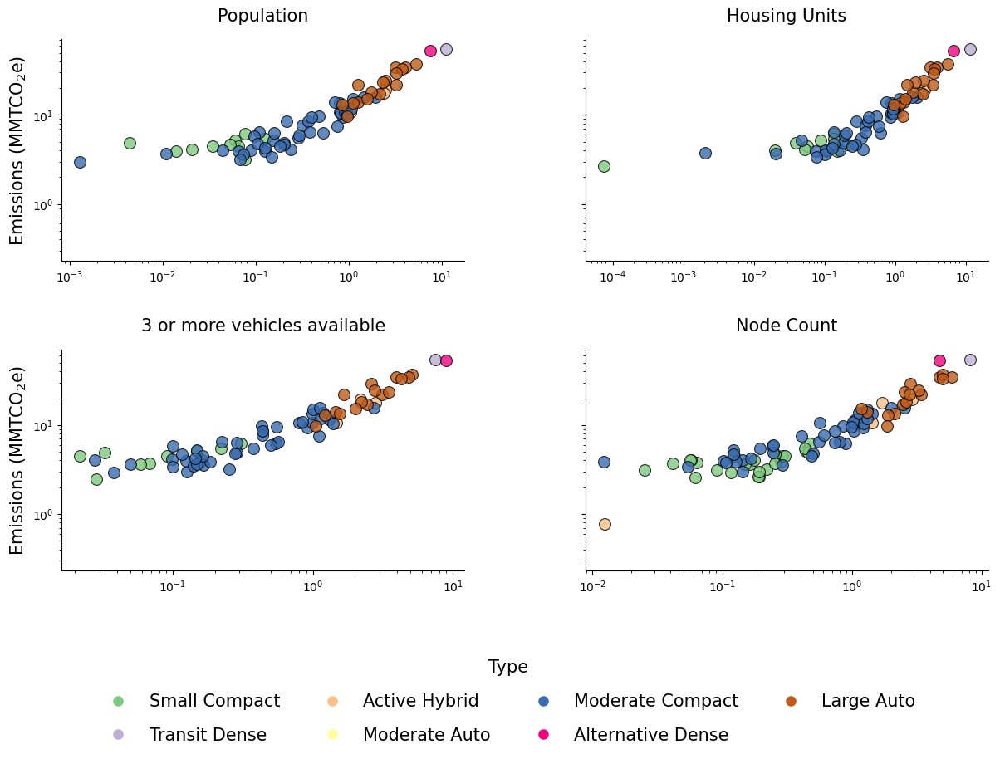

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the list of columns you want to plot against 'Emissions per capita'
columns_to_plot = ['Population','Housing Units', '3 or more vehicles available','Node Count']

# Define your custom color palette for the clusters
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']

# Mapping cluster numbers to descriptive names
cluster_mapping = {
    1: 'Small Compact',
    2: 'Transit Dense',
    3: 'Active Hybrid',
    4: 'Moderate Auto',
    5: 'Moderate Compact',
    6: 'Alternative Dense',
    7: 'Large Auto'
}

# Map colors to clusters
cluster_colors = dict(zip(cluster_mapping.keys(), custom_palette))

# Apply the mapping to the 'Cluster' column in your DataFrame
raw['Cluster Name'] = raw['Cluster'].map(cluster_mapping)

# Ensure no NaNs in 'Cluster' and 'Emissions per capita'
raw_clean = raw.dropna(subset=['Cluster', 'carbon dioxide equivalent (MMTCO2e)'])

# Convert the DataFrame to long format for easier plotting
melted_df = raw_clean.melt(id_vars=['Cluster', 'Cluster Name', 'carbon dioxide equivalent (MMTCO2e)'], 
                           value_vars=columns_to_plot, 
                           var_name='Variable', 
                           value_name='Value')

# Check unique clusters in DataFrame and color dictionary
data_clusters = set(melted_df['Cluster'].unique())
color_clusters = set(cluster_colors.keys())

print("Unique Clusters in DataFrame:", data_clusters)
print("Cluster Colors Dictionary Keys:", color_clusters)

# Identify missing clusters
missing_clusters = data_clusters - color_clusters
if missing_clusters:
    print("Missing Clusters in color dictionary:", missing_clusters)
    raise ValueError("Some cluster values in the data do not have corresponding colors in the cluster_colors dictionary.")

# Create the FacetGrid with scatter plots for each variable
g = sns.FacetGrid(melted_df, col='Variable', col_wrap=2, height=4, aspect=1.5, 
                  hue='Cluster', palette=cluster_colors, sharex=False)

# Map the scatterplot to the grid
g.map(sns.scatterplot, 'Value', 'carbon dioxide equivalent (MMTCO2e)', edgecolor='black', alpha=0.8, s=100)

# Set log scales for the x and y axes
g.set(xscale='log', yscale='log')

# Add the legend manually to ensure cluster names are used
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=cluster_colors[k], markersize=10, label=cluster_mapping[k]) for k in cluster_mapping]
g.fig.legend(handles=handles, bbox_to_anchor=(0.5, -0.01), loc='upper center', ncol=4, fontsize=15, frameon=False, title="Type", title_fontsize=15, labelspacing=1)

# Set axis labels and plot titles
g.set_axis_labels('', 'Emissions (MMTCO$_2$e)', fontsize=15)
g.set_titles(col_template='{col_name}', size=15, y=1.05)  # Adjust y to move the titles higher

# Adjust the layout: increase space between plots and title-x-axis
g.fig.subplots_adjust(top=0.9, bottom=0.1, wspace=0.3, hspace=0.4)  # wspace and hspace control space between plots

# Save the figure with bbox_inches='tight'
plt.savefig('../../figures/variable-emissions-scatter.jpg', dpi=600, bbox_inches='tight')


Unique Clusters in DataFrame: {1, 2, 3, 4, 5, 6, 7}
Cluster Colors Dictionary Keys: {1, 2, 3, 4, 5, 6, 7}


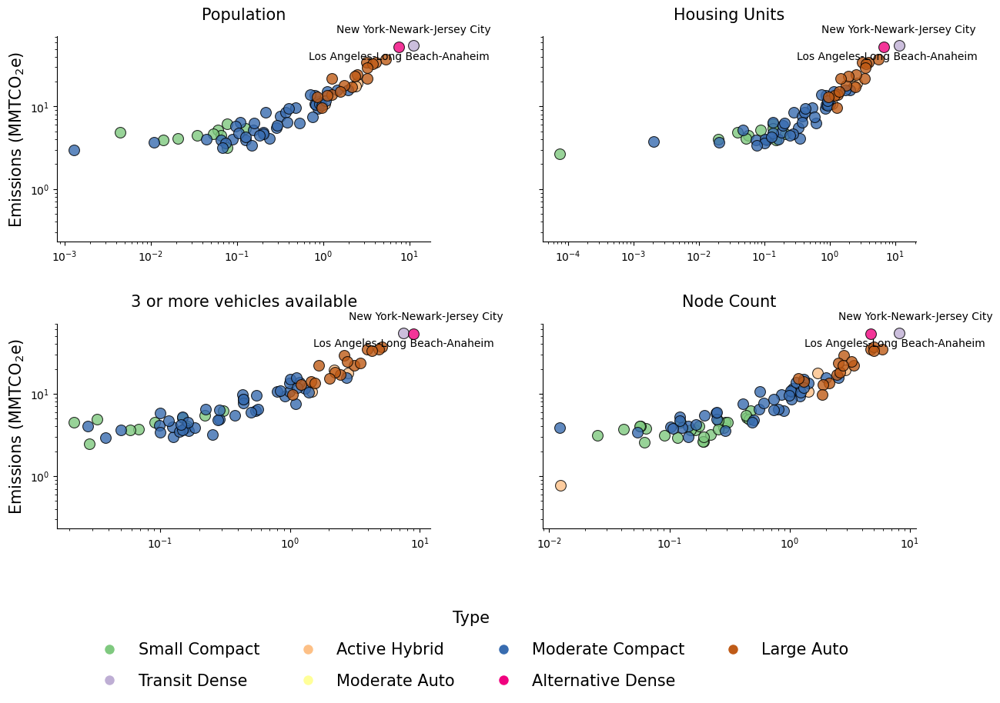

In [33]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the list of columns you want to plot against 'Emissions per capita'
columns_to_plot = ['Population','Housing Units', '3 or more vehicles available','Node Count']

# Define your custom color palette for the clusters
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']

# Mapping cluster numbers to descriptive names
cluster_mapping = {
    1: 'Small Compact',
    2: 'Transit Dense',
    3: 'Active Hybrid',
    4: 'Moderate Auto',
    5: 'Moderate Compact',
    6: 'Alternative Dense',
    7: 'Large Auto'
}

# Map colors to clusters
cluster_colors = dict(zip(cluster_mapping.keys(), custom_palette))

# Apply the mapping to the 'Cluster' column in your DataFrame
raw['Cluster Name'] = raw['Cluster'].map(cluster_mapping)

# Ensure no NaNs in 'Cluster' and 'Emissions per capita'
raw_clean = raw.dropna(subset=['Cluster', 'carbon dioxide equivalent (MMTCO2e)'])

# Convert the DataFrame to long format for easier plotting
melted_df = raw_clean.melt(id_vars=['Cluster', 'Cluster Name', 'carbon dioxide equivalent (MMTCO2e)'], 
                           value_vars=columns_to_plot, 
                           var_name='Variable', 
                           value_name='Value')

# Check unique clusters in DataFrame and color dictionary
data_clusters = set(melted_df['Cluster'].unique())
color_clusters = set(cluster_colors.keys())

print("Unique Clusters in DataFrame:", data_clusters)
print("Cluster Colors Dictionary Keys:", color_clusters)

# Identify missing clusters
missing_clusters = data_clusters - color_clusters
if missing_clusters:
    print("Missing Clusters in color dictionary:", missing_clusters)
    raise ValueError("Some cluster values in the data do not have corresponding colors in the cluster_colors dictionary.")

# Create the FacetGrid with scatter plots for each variable
g = sns.FacetGrid(melted_df, col='Variable', col_wrap=2, height=4, aspect=1.5, 
                  hue='Cluster', palette=cluster_colors, sharex=False)

# Map the scatterplot to the grid
g.map(sns.scatterplot, 'Value', 'carbon dioxide equivalent (MMTCO2e)', edgecolor='black', alpha=0.8, s=100)

# Simplified MSA names
msa_names = {
    'New York-Newark-Jersey City, NY-NJ-PA': 'New York-Newark-Jersey City',
    'Los Angeles-Long Beach-Anaheim, CA': 'Los Angeles-Long Beach-Anaheim'
}

# Annotate New York and Los Angeles with simplified names
for ax in g.axes.flat:
    for full_name, short_name in msa_names.items():
        msa_data = raw_clean[raw_clean['msa'] == full_name]
        if not msa_data.empty:
            x = msa_data[columns_to_plot].values.flatten()
            y = msa_data['carbon dioxide equivalent (MMTCO2e)'].values[0]
            
            # Offset values to avoid overlap
            offset = 12 if short_name == 'New York-Newark-Jersey City' else -12
            ax.annotate(short_name, (x[0], y), textcoords="offset points", xytext=(0, offset), ha='center')

# Set log scales for the x and y axes
g.set(xscale='log', yscale='log')

# Add the legend manually to ensure cluster names are used
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=cluster_colors[k], markersize=10, label=cluster_mapping[k]) for k in cluster_mapping]
g.fig.legend(handles=handles, bbox_to_anchor=(0.5, -0.01), loc='upper center', ncol=4, fontsize=15, frameon=False, title="Type", title_fontsize=15, labelspacing=1)

# Set axis labels and plot titles
g.set_axis_labels('', 'Emissions (MMTCO$_2$e)', fontsize=15)
g.set_titles(col_template='{col_name}', size=15, y=1.05)  # Adjust y to move the titles higher

# Adjust the layout: increase space between plots and title-x-axis
g.fig.subplots_adjust(top=0.9, bottom=0.1, wspace=0.3, hspace=0.4)  # wspace and hspace control space between plots

# Save the figure with bbox_inches='tight'
plt.savefig('../../figures/variable-emissions-scatter.jpg', dpi=600, bbox_inches='tight')

plt.show()


In [23]:
data

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,4
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,5
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,4
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,4
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,5
...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,1
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,1
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,5
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,4


In [24]:
new_df = merged_df.copy()
new_df

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Total population,Emissions per capita,carbon dioxide equivalent (MMTCO2e)
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,4,171354,9.364594,1.455724
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,5,703286,5.741707,3.663268
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,4,147431,7.208870,0.964166
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,4,127216,7.577689,0.874529
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,5,880766,5.014498,4.006672
...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,1,250649,5.369176,1.220870
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,1,447628,4.662592,1.893391
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,5,538115,5.741362,2.802759
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,4,173839,3.336922,0.526246


In [25]:
new_df['Emissions per capita (MTCO2e)']=new_df['Emissions per capita']*0.91

In [26]:
# Create a mapping for cluster names
cluster_mapping = {
    1: 'Small Compact',
    2: 'Transit Dense',
    3: 'Active Hybrid',
    4: 'Moderate Auto',
    5: 'Moderate Compact',
    6: 'Alternative Dense',
    7: 'Large Auto'
}

# Replace numerical cluster values with names in the new DataFrame
new_df['Cluster'] = new_df['Cluster'].replace(cluster_mapping)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_26232\3189803525.py:13: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  new_df['Cluster'] = new_df['Cluster'].replace(cluster_mapping)


In [27]:
new_df

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Total population,Emissions per capita,carbon dioxide equivalent (MMTCO2e),Emissions per capita (MTCO2e)
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,Moderate Auto,171354,9.364594,1.455724,8.521780
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,Moderate Compact,703286,5.741707,3.663268,5.224953
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,Moderate Auto,147431,7.208870,0.964166,6.560072
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,Moderate Auto,127216,7.577689,0.874529,6.895697
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,Moderate Compact,880766,5.014498,4.006672,4.563193
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,Small Compact,250649,5.369176,1.220870,4.885950
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,Small Compact,447628,4.662592,1.893391,4.242959
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,Moderate Compact,538115,5.741362,2.802759,5.224640
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,Moderate Auto,173839,3.336922,0.526246,3.036599


C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_26232\1531349827.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(x='carbon dioxide equivalent (MMTCO2e)', y='Cluster', data=new_df, palette=custom_palette)


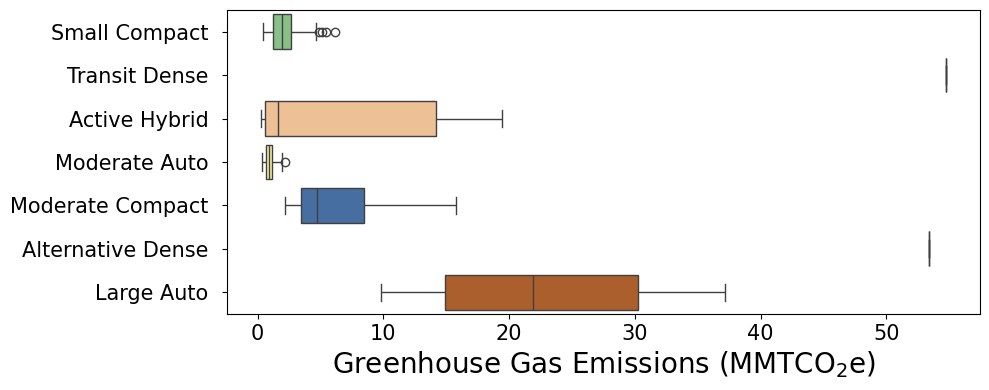

In [28]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import ListedColormap

# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter = ListedColormap(custom_palette)

# Plot
plt.figure(figsize=(10, 4))  # Increase the size for better visibility
ax = sns.boxplot(x='carbon dioxide equivalent (MMTCO2e)', y='Cluster', data=new_df, palette=custom_palette)

# Customize labels and ticks
plt.xlabel('Greenhouse Gas Emissions (MMTCO$_2$e)', fontsize=20)
plt.ylabel('', fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)

# Adjust label padding
ax.tick_params(axis='y', pad=10)  # Increase padding if needed

# Adjust layout
plt.tight_layout()

# Save the figure with higher DPI
plt.savefig('../../figures/cluster-emissions-boxplot.jpg', dpi=600)

# Show the plot
plt.show()


C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_26232\2455987015.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(x='Emissions per capita (MTCO2e)', y='Cluster', data=new_df, palette=custom_palette)


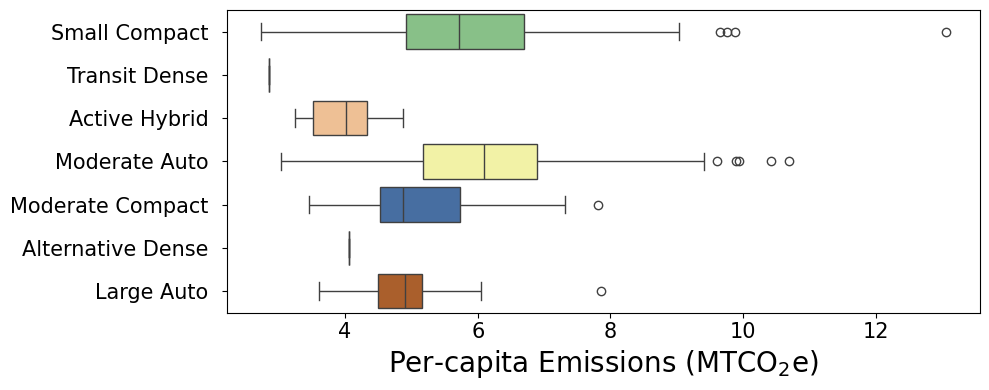

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import ListedColormap

# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter = ListedColormap(custom_palette)

# Plot
plt.figure(figsize=(10, 4))
ax = sns.boxplot(x='Emissions per capita (MTCO2e)', y='Cluster', data=new_df, palette=custom_palette)

# Customize labels and ticks
plt.xlabel('Per-capita Emissions (MTCO$_2$e)', fontsize=20)
plt.ylabel('', fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)

# Adjust label padding
ax.tick_params(axis='y', pad=10)  # Increase padding if needed

# Adjust layout
plt.tight_layout()


# Save the figure
plt.savefig('../../figures/cluster-emissions-per-capita-boxplot.jpg', dpi=600)

# Show the plot
plt.show()

In [30]:
new_df

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Total population,Emissions per capita,carbon dioxide equivalent (MMTCO2e),Emissions per capita (MTCO2e)
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,Moderate Auto,171354,9.364594,1.455724,8.521780
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,Moderate Compact,703286,5.741707,3.663268,5.224953
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,Moderate Auto,147431,7.208870,0.964166,6.560072
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,Moderate Auto,127216,7.577689,0.874529,6.895697
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,Moderate Compact,880766,5.014498,4.006672,4.563193
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,Small Compact,250649,5.369176,1.220870,4.885950
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,Small Compact,447628,4.662592,1.893391,4.242959
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,Moderate Compact,538115,5.741362,2.802759,5.224640
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,Moderate Auto,173839,3.336922,0.526246,3.036599


In [31]:
import pandas as pd
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_percentage_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, GridSearchCV
import numpy as np

# Assuming 'raw' is your DataFrame and 'merged_df' contains your target variables
# Encode the cluster labels as categorical variables
raw['Cluster'] = raw['Cluster'].astype('category')

# One-hot encode the categorical variables
X = pd.get_dummies(raw.drop(columns=['msa']), drop_first=False)
y_emissions = new_df['carbon dioxide equivalent (MMTCO2e)']
y_emissions_per_capita = new_df['Emissions per capita (MTCO2e)']

# Split data into training and testing sets
X_train, X_test, y_train_emissions, y_test_emissions = train_test_split(X, y_emissions, test_size=0.3, random_state=42)
_, _, y_train_emissions_per_capita, y_test_emissions_per_capita = train_test_split(X, y_emissions_per_capita, test_size=0.3, random_state=42)

# Determine the size of the training set
print('Training set size:', X_train.shape[0])

# Function to perform grid search without OOB error
def grid_search_rf(X_train, y_train):
    param_grid = {
        'n_estimators': [100, 200],
        'max_features': [4, 6, 8, 10, 12, 14],
        'max_depth': [None, 10, 20, 30],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'ccp_alpha': [0.0, 0.01, 0.001]
    }
    
    # Initialize the model
    rf = RandomForestRegressor(random_state=42)
    grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error', n_jobs=-1, verbose=2)
    grid_search.fit(X_train, y_train)
    best_rf = grid_search.best_estimator_
    return best_rf

# Function to calculate metrics
def calculate_metrics(model, X_train, X_test, y_train, y_test):
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)
    
    metrics = {
        'MSE': [mean_squared_error(y_train, y_train_pred), mean_squared_error(y_test, y_test_pred)],
        'R-squared': [r2_score(y_train, y_train_pred), r2_score(y_test, y_test_pred)],
        'MAPE': [mean_absolute_percentage_error(y_train, y_train_pred), mean_absolute_percentage_error(y_test, y_test_pred)],
        'RMSE': [np.sqrt(mean_squared_error(y_train, y_train_pred)), np.sqrt(mean_squared_error(y_test, y_test_pred))]
    }
    
    return pd.DataFrame(metrics, index=['Train', 'Test']), y_test_pred

# Train model to predict emissions from all MSAs
best_rf_emissions = grid_search_rf(X_train, y_train_emissions)
emissions_metrics, y_pred_emissions = calculate_metrics(best_rf_emissions, X_train, X_test, y_train_emissions, y_test_emissions)

# Train model to predict emissions per capita from all MSAs
best_rf_emissions_per_capita = grid_search_rf(X_train, y_train_emissions_per_capita)
emissions_per_capita_metrics, y_pred_emissions_per_capita = calculate_metrics(best_rf_emissions_per_capita, X_train, X_test, y_train_emissions_per_capita, y_test_emissions_per_capita)


Training set size: 248
Fitting 3 folds for each of 1296 candidates, totalling 3888 fits
Fitting 3 folds for each of 1296 candidates, totalling 3888 fits


In [31]:
emissions_metrics

,MSE,R-squared,MAPE,RMSE
Train,0.637406,0.979945,0.044717,0.798377
Test,7.572184,0.890174,0.103586,2.751760


In [23]:
emissions_per_capita_metrics

,MSE,R-squared,MAPE,RMSE
Train,0.312688,0.842714,0.071472,0.559185
Test,1.620076,0.302617,0.165020,1.272822


In [24]:
y_pred_emissions

array([34.49422397,  1.77451728,  3.45509026,  0.73685111,  4.41815201,
        0.58582383, 25.09793987, 14.34814347,  2.25954942,  0.7485242 ,
        2.47143663,  2.5802625 ,  2.21658866,  0.86622712,  2.23693769,
        0.78683849,  1.43301663, 25.75484793,  0.71345867,  1.83842419,
        0.96379588,  0.60632765,  1.00355291,  0.98497428,  1.07757568,
        2.90300169,  2.90215381,  3.72190293,  0.56188492, 11.24929757,
        0.80342512,  0.82901336,  0.82654589,  2.79467821,  1.14029815,
        1.09655886,  0.97233303,  2.15913023,  0.95034437,  1.1743145 ,
        2.77222098,  1.30854046,  3.24159424,  1.18466565,  0.68215928,
        0.75041907,  1.78046308,  5.78013597,  0.86884725,  1.87647205,
        2.13044715,  0.95198958,  0.72066201, 26.54647801,  3.61101543,
        1.11098495,  0.7863299 ,  2.88659626,  2.14427272,  2.67915216,
        1.8729896 ,  1.16559609,  1.08017795,  0.56000574,  0.55055714,
        1.03413617,  0.91402044,  0.81719889,  0.54424334,  3.64

In [25]:
emissions_metrics

,MSE,R-squared,MAPE,RMSE
Train,0.731840,0.976973,0.065720,0.855476
Test,6.808664,0.901248,0.169384,2.609342


In [26]:
emissions_per_capita_metrics

,MSE,R-squared,MAPE,RMSE
Train,0.312688,0.842714,0.071472,0.559185
Test,1.620076,0.302617,0.165020,1.272822


In [27]:
raw

,msa,Cluster,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),...,Other Fuel (gal/gal equivalent),Electric Propulsion (kwh),Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km)
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.097156,-0.097615,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.097156,-0.097615,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.097156,-0.097615,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.097156,-0.097615,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.097156,-0.097615,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.097156,-0.097615,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.097156,-0.097615,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.097156,-0.097615,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.097156,-0.097615,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031


In [28]:
# Plot box plot for emissions by type
raw['Predicted Emissions'] = best_rf_emissions.predict(X)
raw['Predicted Emissions Per Capita'] = best_rf_emissions_per_capita.predict(X)

In [29]:
raw_1=raw.copy()

In [30]:
raw_1

,msa,Cluster,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),...,Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km),Predicted Emissions,Predicted Emissions Per Capita
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731,1.330447,7.853072
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119,3.654744,5.119156
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396,0.955303,6.493496
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188,0.786330,6.856672
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205,4.233453,4.730145
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257,1.409603,6.843518
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224,2.216589,5.048403
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285,2.930184,5.301794
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031,0.684184,4.647324


C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11428\2111357229.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(x='Predicted Emissions', y='Cluster', data=raw, palette=custom_palette)


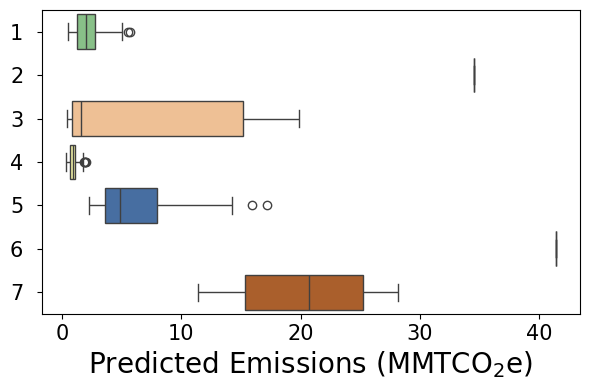

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11428\2111357229.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(x='Predicted Emissions Per Capita', y='Cluster', data=raw, palette=custom_palette)


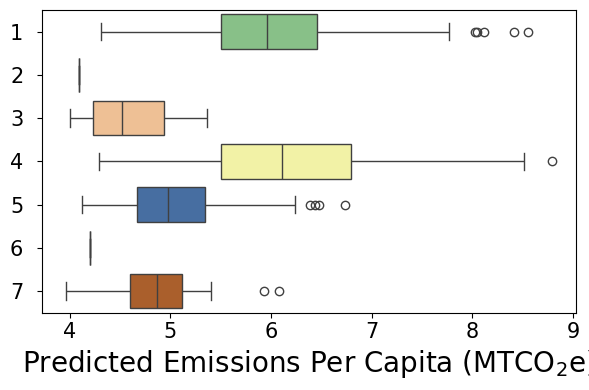

In [31]:
# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter = ListedColormap(custom_palette)
plt.figure(figsize=(6, 4))
ax = sns.boxplot(x='Predicted Emissions', y='Cluster', data=raw, palette=custom_palette)
# Customize labels and ticks
plt.xlabel('Predicted Emissions (MMTCO$_2$e)', fontsize=20)
plt.ylabel('', fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)
# Adjust label padding
ax.tick_params(axis='y', pad=10)  # Increase padding if needed
# Adjust layout
plt.tight_layout()
# Save the figure
plt.savefig('../../figures/cluster--predicted-emissions-boxplot-with-cluster.jpg', dpi=600)
# Show the plot
plt.show()


# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter = ListedColormap(custom_palette)
plt.figure(figsize=(6, 4))
ax = sns.boxplot(x='Predicted Emissions Per Capita', y='Cluster', data=raw, palette=custom_palette)
# Customize labels and ticks
plt.xlabel('Predicted Emissions Per Capita (MTCO$_2$e)', fontsize=20)
plt.ylabel('', fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)
# Adjust label padding
ax.tick_params(axis='y', pad=10)  # Increase padding if needed
# Adjust layout
plt.tight_layout()
# Save the figure
plt.savefig('../../figures/cluster--predicted-emissions-per-capita-boxplot-with-cluster.jpg', dpi=600)
# Show the plot
plt.show()

In [32]:
raw_2=raw_1.copy()

In [33]:
raw_2

,msa,Cluster,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),...,Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km),Predicted Emissions,Predicted Emissions Per Capita
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731,1.330447,7.853072
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119,3.654744,5.119156
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396,0.955303,6.493496
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188,0.786330,6.856672
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205,4.233453,4.730145
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257,1.409603,6.843518
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224,2.216589,5.048403
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285,2.930184,5.301794
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031,0.684184,4.647324


In [34]:
raw_4=raw_1.copy()

In [35]:
raw_4

,msa,Cluster,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),...,Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km),Predicted Emissions,Predicted Emissions Per Capita
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731,1.330447,7.853072
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119,3.654744,5.119156
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396,0.955303,6.493496
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188,0.786330,6.856672
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205,4.233453,4.730145
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257,1.409603,6.843518
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224,2.216589,5.048403
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285,2.930184,5.301794
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031,0.684184,4.647324


In [36]:
raw=raw_1.copy()

In [37]:
raw

,msa,Cluster,Node count,Edge count,Degree average,Edge length total (km),Edge length average (km),Streets per node average,Intersection count,Street length total (km),...,Electric Battery (kwh),Diesel (miles),Gasoline (miles),Compressed Natural Gas (miles),Other Fuel (miles),Electric Propulsion (miles),Electric Battery (miles),Population density (people/sq km),Predicted Emissions,Predicted Emissions Per Capita
0,"Abilene, TX",4,-0.340119,-0.313531,1.394284,-0.089796,1.204496,1.187439,-0.308795,-0.105106,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.707731,1.330447,7.853072
1,"Akron, OH",5,-0.073031,-0.045155,0.627727,-0.180780,-0.989995,0.364867,-0.058596,-0.179483,...,-0.152178,-0.067667,-0.205368,0.195232,-0.201659,-0.089999,-0.149891,1.806119,3.654744,5.119156
2,"Albany, GA",4,-0.465912,-0.454650,1.053723,-0.440662,1.028113,0.896967,-0.442272,-0.435458,...,-0.152178,-0.229501,-0.315604,-0.127940,-0.201659,-0.089999,-0.149891,-0.602396,0.955303,6.493496
3,"Albany-Lebanon, OR",4,-0.494398,-0.496671,-0.307877,-0.498871,1.468872,-0.881657,-0.492269,-0.499597,...,-0.152178,-0.239195,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.733188,0.786330,6.856672
4,"Albany-Schenectady-Troy, NY",5,0.142895,0.176087,0.485957,0.402801,-0.262060,0.357593,0.185299,0.367444,...,-0.064929,0.326039,-0.047941,-0.180041,-0.201659,-0.089999,-0.149891,0.169205,4.233453,4.730145
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1,-0.413511,-0.402984,0.682944,-0.228503,1.739652,0.055046,-0.406768,-0.245774,...,-0.152178,-0.191356,-0.262700,-0.180041,-0.201659,-0.089999,-0.149891,-0.722257,1.409603,6.843518
351,"York-Hanover, PA",1,-0.291754,-0.270291,0.894350,-0.268256,-0.152058,0.525332,-0.265829,-0.280884,...,-0.152178,-0.205427,0.948860,-0.114442,-0.201659,-0.089999,-0.149891,0.836224,2.216589,5.048403
352,"Youngstown-Warren-Boardman, OH-PA",5,-0.115311,-0.081366,0.913208,0.028462,-0.178701,0.614765,-0.091407,0.017118,...,-0.152178,-0.143107,-0.220272,-0.180041,-0.201659,-0.089999,-0.149891,0.178285,2.930184,5.301794
353,"Yuba City, CA",4,-0.466916,-0.464644,0.148688,-0.515182,0.511774,-0.153088,-0.458354,-0.510606,...,-0.152178,-0.178559,-0.318118,-0.180041,-0.201659,-0.089999,-0.149891,-0.432031,0.684184,4.647324


C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11428\3973053066.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(x='Predicted Emissions', y='Cluster', data=raw, palette=custom_palette)


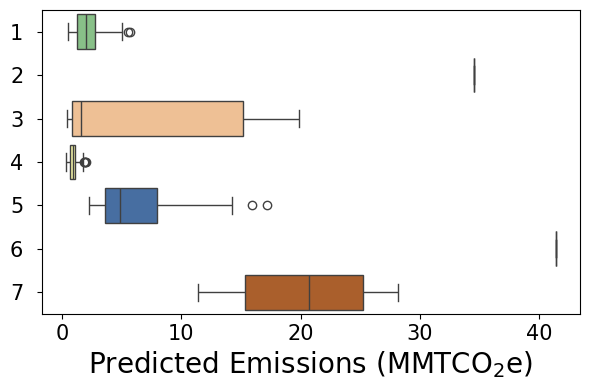

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11428\3973053066.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(x='Predicted Emissions Per Capita', y='Cluster', data=raw, palette=custom_palette)


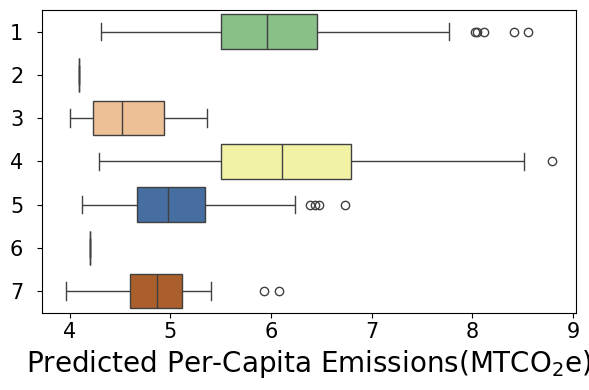

In [38]:
# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter = ListedColormap(custom_palette)
plt.figure(figsize=(6, 4))
ax = sns.boxplot(x='Predicted Emissions', y='Cluster', data=raw, palette=custom_palette)
# Customize labels and ticks
plt.xlabel('Predicted Emissions (MMTCO$_2$e)', fontsize=20)
plt.ylabel('', fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)
# Adjust label padding
ax.tick_params(axis='y', pad=10)  # Increase padding if needed
# Adjust layout
plt.tight_layout()
# Save the figure
plt.savefig('../../figures/cluster--predicted-emissions-boxplot-with-cluster.jpg', dpi=600)
# Show the plot
plt.show()


# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter = ListedColormap(custom_palette)
plt.figure(figsize=(6, 4))
ax = sns.boxplot(x='Predicted Emissions Per Capita', y='Cluster', data=raw, palette=custom_palette)
# Customize labels and ticks
plt.xlabel('Predicted Per-Capita Emissions(MTCO$_2$e)', fontsize=20)
plt.ylabel('', fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(fontsize=15)
# Adjust label padding
ax.tick_params(axis='y', pad=10)  # Increase padding if needed
# Adjust layout
plt.tight_layout()
# Save the figure
plt.savefig('../../figures/cluster--predicted-emissions-per-capita-boxplot-with-cluster.jpg', dpi=600)
# Show the plot
plt.show()

Unique values in Cluster_1: [False  True]
Unique values in Cluster_2: [ True False]
Unique values in Cluster_3: [False  True]
Unique values in Cluster_4: [False  True]
Unique values in Cluster_5: [False  True]
Unique values in Cluster_6: [False]
Unique values in Cluster_7: [False  True]
Unique clusters assigned: ['Type 2' 'Type 1' 'Type 5' 'Type 4' 'Type 7' 'Type 3']


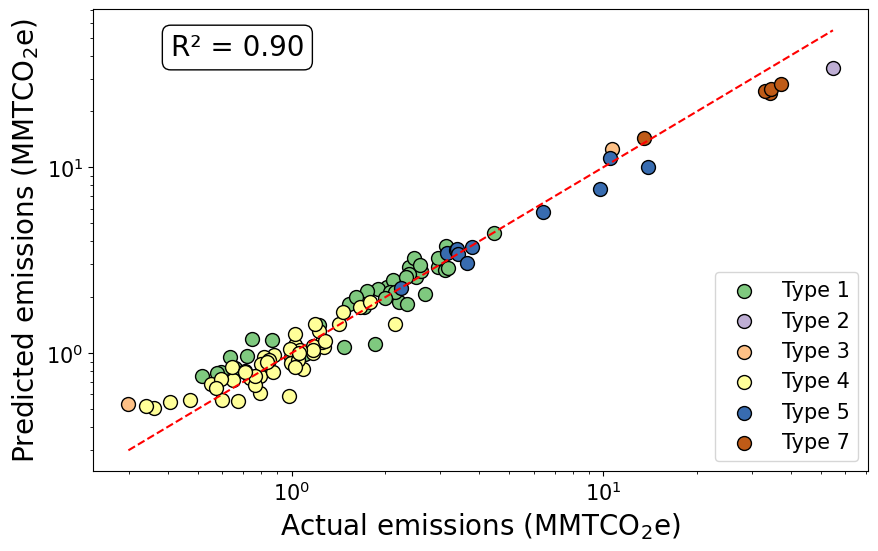

In [39]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import numpy as np
from sklearn.metrics import r2_score
from matplotlib.colors import ListedColormap

# Assuming your dataframe is named df
# Create a single 'Cluster' column
cluster_labels = [f'Type {i}' for i in range(1, 8)]

# Check the unique values in X_test['Cluster'] columns
for i in range(1, 8):
    print(f'Unique values in Cluster_{i}:', X_test[f'Cluster_{i}'].unique())

# Simplified cluster assignment assuming X_test['Cluster_i'] are one-hot encoded
X_test['Cluster'] = 'Unknown'
for i, label in enumerate(cluster_labels, start=1):
    X_test.loc[X_test[f'Cluster_{i}'] == 1, 'Cluster'] = label

# Ensure all clusters are correctly assigned
print('Unique clusters assigned:', X_test['Cluster'].unique())

clusters = X_test['Cluster']

# Calculate R-squared
r2 = r2_score(y_test_emissions, y_pred_emissions)

# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#bf5b17']
color_iter = ListedColormap(custom_palette)

unique_clusters = sorted(X_test['Cluster'].unique(), key=lambda x: int(x.split()[-1]) if x != 'Unknown' else float('inf'))

# Main Plot
fig, ax = plt.subplots(figsize=(10, 6))

# Set the background color of the figure and axes
#fig.patch.set_facecolor('lightgray')  # Figure background color
# ax.set_facecolor('lightgray')  # Axes background color

# Plot each cluster with different colors using the custom palette
for cluster, color in zip(unique_clusters, custom_palette):
    idx = clusters == cluster
    ax.scatter(y_test_emissions[idx], y_pred_emissions[idx], alpha=1, label=cluster, color=color, edgecolor='black',s=100)

ax.plot([min(y_test_emissions), max(y_test_emissions)], [min(y_test_emissions), max(y_test_emissions)], color='red', linestyle='--')  # Diagonal line
ax.set_xlabel('Actual emissions (MMTCO$_2$e)', fontsize=20)
ax.set_ylabel('Predicted emissions (MMTCO$_2$e)', fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=15)

# Set log-log scale
ax.set_xscale('log')
ax.set_yscale('log')

# Add R-squared annotation
ax.annotate(f'R² = {r2:.2f}', xy=(0.1, 0.9), xycoords='axes fraction', fontsize=20,
            bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='white'))

# Add legend at the lower right side
ax.legend(loc='lower right',fontsize=15)

plt.savefig('../../figures/actual-predicted-emissions-with-cluster.jpg', dpi=600)
plt.show()


Unique values in Cluster_1: [False  True]
Unique values in Cluster_2: [ True False]
Unique values in Cluster_3: [False  True]
Unique values in Cluster_4: [False  True]
Unique values in Cluster_5: [False  True]
Unique values in Cluster_6: [False]
Unique values in Cluster_7: [False  True]
Unique clusters assigned: ['Transit Dense' 'Small Compact' 'Moderate Compact' 'Moderate Auto'
 'Unknown' 'Active Hybrid']


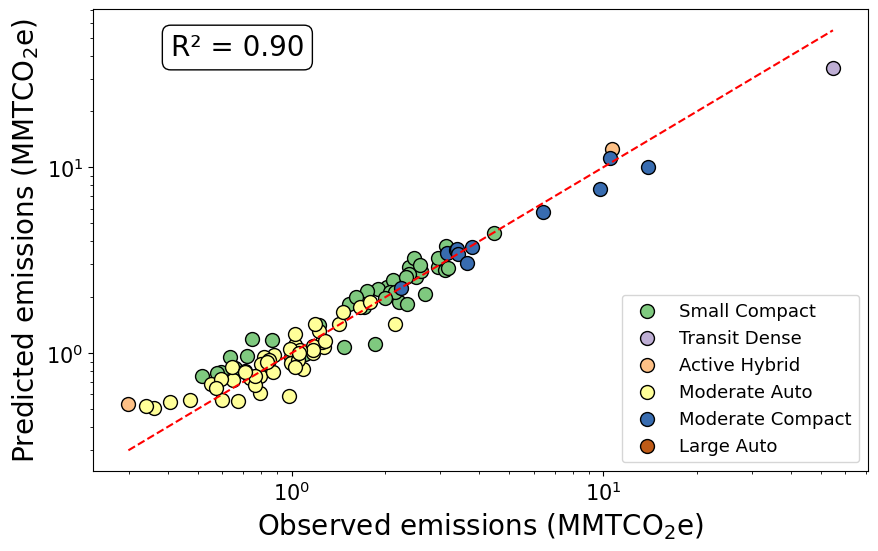

In [40]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import numpy as np
from sklearn.metrics import r2_score
from matplotlib.colors import ListedColormap

# Assuming your dataframe is named df
# Create a single 'Cluster' column with the new names
cluster_labels = [
    'Small Compact', 
    'Transit Dense', 
    'Active Hybrid', 
    'Moderate Auto', 
    'Moderate Compact', 
    'Large Auto'
]

# Check the unique values in X_test['Cluster'] columns
for i in range(1, 8):
    print(f'Unique values in Cluster_{i}:', X_test[f'Cluster_{i}'].unique())

# Simplified cluster assignment assuming X_test['Cluster_i'] are one-hot encoded
X_test['Cluster'] = 'Unknown'
for i, label in enumerate(cluster_labels, start=1):
    X_test.loc[X_test[f'Cluster_{i}'] == 1, 'Cluster'] = label

# Ensure all clusters are correctly assigned
print('Unique clusters assigned:', X_test['Cluster'].unique())

clusters = X_test['Cluster']

# Calculate R-squared
r2 = r2_score(y_test_emissions, y_pred_emissions)

# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#bf5b17']
color_iter = ListedColormap(custom_palette)

# Sort clusters by their order in the cluster_labels
unique_clusters = sorted(cluster_labels, key=lambda x: cluster_labels.index(x))

# Main Plot
fig, ax = plt.subplots(figsize=(10, 6))

# Set the background color of the figure and axes
# fig.patch.set_facecolor('lightgray')  # Figure background color
# ax.set_facecolor('lightgray')  # Axes background color

# Plot each cluster with different colors using the custom palette
for cluster, color in zip(unique_clusters, custom_palette):
    idx = clusters == cluster
    ax.scatter(y_test_emissions[idx], y_pred_emissions[idx], alpha=1, label=cluster, color=color, edgecolor='black', s=100)

ax.plot([min(y_test_emissions), max(y_test_emissions)], [min(y_test_emissions), max(y_test_emissions)], color='red', linestyle='--')  # Diagonal line
ax.set_xlabel('Observed emissions (MMTCO$_2$e)', fontsize=20)
ax.set_ylabel('Predicted emissions (MMTCO$_2$e)', fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=15)

# Set log-log scale
ax.set_xscale('log')
ax.set_yscale('log')

# Add R-squared annotation
ax.annotate(f'R² = {r2:.2f}', xy=(0.1, 0.9), xycoords='axes fraction', fontsize=20,
            bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='white'))

# Add legend at the lower right side
ax.legend(loc='lower right', fontsize=13)

plt.savefig('../../figures/actual-predicted-emissions-with-cluster.jpg', dpi=600)
# plt.show()


Unique values in Cluster_1: [False  True]
Unique values in Cluster_2: [ True False]
Unique values in Cluster_3: [False  True]
Unique values in Cluster_4: [False  True]
Unique values in Cluster_5: [False  True]
Unique values in Cluster_6: [False]
Unique values in Cluster_7: [False  True]
Unique clusters assigned: ['Transit Dense' 'Small Compact' 'Moderate Compact' 'Moderate Auto'
 'Large Auto' 'Active Hybrid']


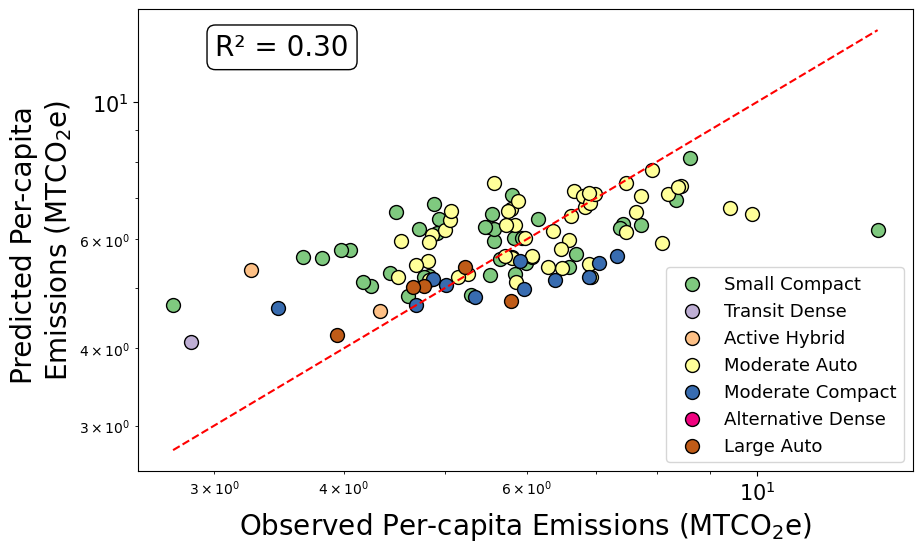

In [41]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score
from matplotlib.colors import ListedColormap

# Assuming your dataframe is named df
cluster_labels = [
    'Small Compact', 
    'Transit Dense', 
    'Active Hybrid', 
    'Moderate Auto', 
    'Moderate Compact', 
    'Alternative Dense',
    'Large Auto'
]
# Check the unique values in X_test['Cluster'] columns
for i in range(1, 8):
    print(f'Unique values in Cluster_{i}:', X_test[f'Cluster_{i}'].unique())

# Simplified cluster assignment assuming X_test['Cluster_i'] are one-hot encoded
X_test['Cluster'] = 'Unknown'
for i, label in enumerate(cluster_labels, start=1):
    X_test.loc[X_test[f'Cluster_{i}'] == 1, 'Cluster'] = label

# Ensure all clusters are correctly assigned
print('Unique clusters assigned:', X_test['Cluster'].unique())

clusters = X_test['Cluster']


# Calculate R-squared
r2 = r2_score(y_test_emissions_per_capita, y_pred_emissions_per_capita)

# Define custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter = ListedColormap(custom_palette)

# Ensure the order of the unique clusters matches the cluster_labels
unique_clusters = cluster_labels 

# Main Plot
fig, ax = plt.subplots(figsize=(10, 6))

# Plot each cluster with different colors using the custom palette
for cluster, color in zip(unique_clusters, custom_palette + ['gray']):
    idx = clusters == cluster
    ax.scatter(y_test_emissions_per_capita[idx], y_pred_emissions_per_capita[idx], alpha=1, label=cluster, color=color, edgecolor='black', s=100)

ax.plot([min(y_test_emissions_per_capita), max(y_test_emissions_per_capita)], [min(y_test_emissions_per_capita), max(y_test_emissions_per_capita)], color='red', linestyle='--')  # Diagonal line
ax.set_xlabel('Observed Per-capita Emissions (MTCO$_2$e)', fontsize=20)
ax.set_ylabel('Predicted Per-capita \nEmissions (MTCO$_2$e)', fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=15)

# Set log-log scale
ax.set_xscale('log')
ax.set_yscale('log')

# Add R-squared annotation
ax.annotate(f'R² = {r2:.2f}', xy=(0.1, 0.9), xycoords='axes fraction', fontsize=20,
            bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='white'))

# Add legend at the lower right side
ax.legend(loc='lower right', fontsize=13)

plt.savefig('../../figures/actual-predicted-emissions-per-capita-with-cluster.jpg', dpi=600)
plt.show()


In [42]:
X.columns

Index(['Node count', 'Edge count', 'Degree average', 'Edge length total (km)',
       'Edge length average (km)', 'Streets per node average',
       'Intersection count', 'Street length total (km)',
       'Street segment count', 'Street length average (km)',
       'Circuity average', 'Self-loop proportion', 'Node density (per sq km)',
       'Intersection density (per sq km)', 'Edge density (km/sq km)',
       'Street density (km/sq km)', 'Building area (sq km)', 'Area (sq km)',
       'Car, truck, or van:', 'Public transportation (excluding taxicab):',
       'Bicycle', 'Walked', 'Worked from home', 'Median Income',
       'Employment Rate', 'Unemployment Rate', 'Total population',
       'Total housing units', 'No vehicles available', '1 vehicle available',
       '2 vehicles available', '3 or more vehicles available', 'GDP',
       'Diesel (gal)', 'Gasoline (gal)',
       'Liquefied Petroleum Gas (gal equivalent)',
       'Compressed Natural Gas (gal equivalent)', 'Bio-Diesel (gal

In [43]:
# Dictionary to rename columns
rename_dict = {
    'Public transportation (excluding taxicab):': 'Public Transportation',
    'Liquefied Petroleum Gas (gal equivalent)': 'LPG Consumption (GGE)',
    'Compressed Natural Gas (gal equivalent)': 'CNG Consumption (GGE)',
    'Bio-Diesel (gal)': 'Bio-Diesel Consumption (gal)',
    'Other Fuel (gal/gal equivalent)': 'Other Fuel Consumption (GGE)',
    'Electric Propulsion (kwh)': 'Electric Propulsion Consumption (kwh)',
    'Electric Battery (kwh)': 'Electric Battery Consumption (kwh)',
    'Diesel (miles)': 'Diesel Mileage (miles)',
    'Gasoline (miles)': 'Gasoline Mileage (miles)',
    'Compressed Natural Gas (miles)': 'CNG Mileage (miles)',
    'Other Fuel (miles)': 'Other Fuel Mileage (miles)',
    'Electric Propulsion (miles)': 'Electric Propulsion Mileage (miles)',
    'Electric Battery (miles)': 'Electric Battery Mileage (miles)',
    'Population density (people/sq km)': 'Population Density (people/sq km)',
    'Size--Auto (type)':'Small Compact (type)',
    'Network Connectivity (type)':'Alternative Dense (type)',
    'Moderate compact':'Moderate Compact (type)',
    'Moderate Auto':'Moderate Auto (type)'
}

# Rename columns
X.rename(columns=rename_dict, inplace=True)

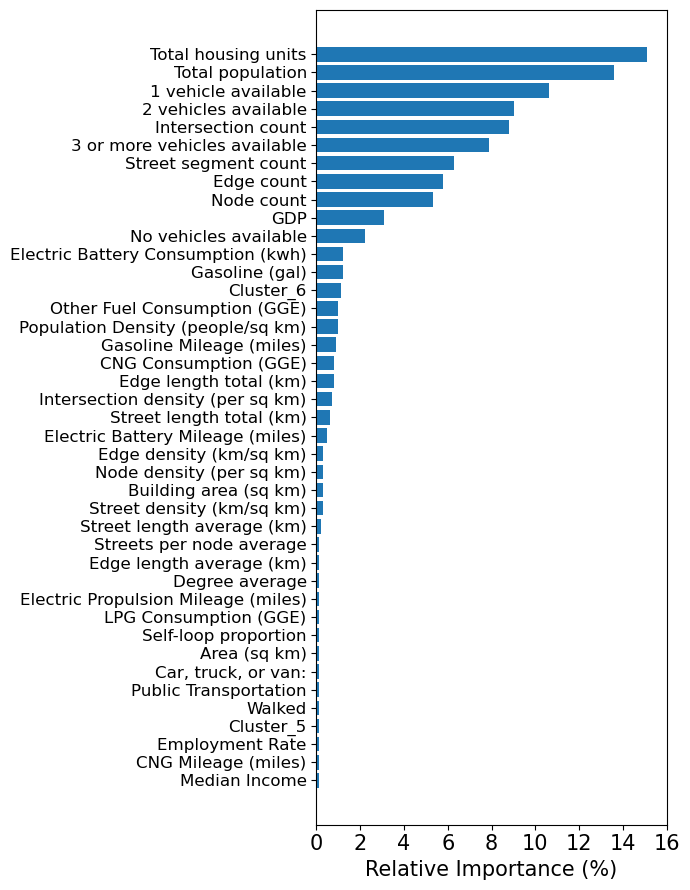

In [44]:
from matplotlib.ticker import MultipleLocator

# Assuming 'best_rf_emissions' and 'X' are already defined in your code
feature_importances_emissions = best_rf_emissions.feature_importances_

feature_importances_emissions = np.round(feature_importances_emissions, 3)

# Create a boolean mask for non-zero importance
non_zero_mask = feature_importances_emissions > 0

# Apply mask to filter out zero importance features
filtered_importances = feature_importances_emissions[non_zero_mask]
filtered_indices = np.where(non_zero_mask)[0]
sorted_indices_emissions = np.argsort(filtered_importances)

# Update feature names and importances based on the filtered data
filtered_feature_names = X.columns[filtered_indices]
sorted_filtered_indices = np.argsort(filtered_importances)

# Plot feature importances for emissions
plt.figure(figsize=(7, 9))  # Adjusted figsize for better readability
plt.barh(range(len(sorted_filtered_indices)), filtered_importances[sorted_filtered_indices]*100, align="center")
plt.yticks(range(len(sorted_filtered_indices)), filtered_feature_names[sorted_filtered_indices], fontsize=12)  # Use yticks for horizontal bars
plt.xticks(fontsize=15)
plt.xlabel("Relative Importance (%)", fontsize=15)  # Add x-axis label

# Set x-axis range
plt.xlim(0, 16)


# Set interval between ticks
plt.gca().xaxis.set_major_locator(MultipleLocator(2))

# Adjust layout to reduce white space
plt.subplots_adjust(left=0.2, right=0.9, top=1, bottom=0.05)

plt.tight_layout()
plt.savefig('../../figures/feature-importance-emissions-with-cluster.jpg', dpi=600)

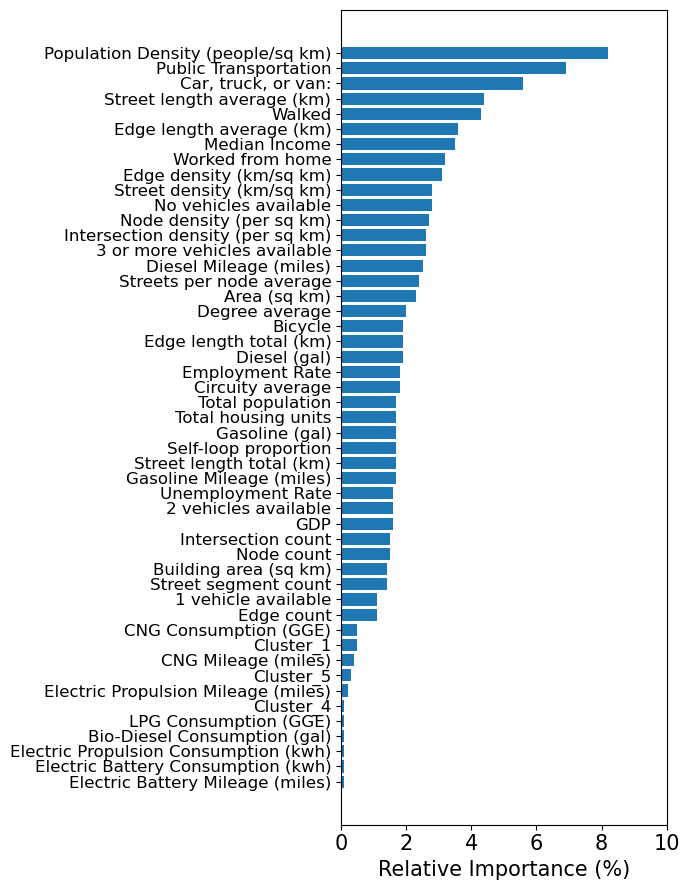

In [45]:
from matplotlib.ticker import MultipleLocator

# Assuming 'best_rf_emissions' and 'X' are already defined in your code
feature_importances_emissions = best_rf_emissions_per_capita.feature_importances_

feature_importances_emissions = np.round(feature_importances_emissions, 3)

# Create a boolean mask for non-zero importance
non_zero_mask = feature_importances_emissions > 0

# Apply mask to filter out zero importance features
filtered_importances = feature_importances_emissions[non_zero_mask]
filtered_indices = np.where(non_zero_mask)[0]
sorted_indices_emissions = np.argsort(filtered_importances)

# Update feature names and importances based on the filtered data
filtered_feature_names = X.columns[filtered_indices]
sorted_filtered_indices = np.argsort(filtered_importances)

# Plot feature importances for emissions
plt.figure(figsize=(7, 9))  # Adjusted figsize for better readability
plt.barh(range(len(sorted_filtered_indices)), filtered_importances[sorted_filtered_indices]*100, align="center")
plt.yticks(range(len(sorted_filtered_indices)), filtered_feature_names[sorted_filtered_indices], fontsize=12)  # Use yticks for horizontal bars
plt.xticks(fontsize=15)
plt.xlabel("Relative Importance (%)", fontsize=15)  # Add x-axis label

# Set x-axis range
plt.xlim(0, 10)


# Set interval between ticks
plt.gca().xaxis.set_major_locator(MultipleLocator(2))

# Adjust layout to reduce white space
plt.subplots_adjust(left=0.2, right=0.9, top=1, bottom=0.05)

plt.tight_layout()
plt.savefig('../../figures/feature-importance-emissions-per-capita-with-cluster.jpg', dpi=600)

Feature ranking for emissions per capita:
1. feature 47 (0.08214678582641946)
2. feature 19 (0.06857241114025013)
3. feature 18 (0.055923768122001116)
4. feature 9 (0.04383521330160062)
5. feature 21 (0.0432984845681137)
6. feature 4 (0.03558351331086284)
7. feature 23 (0.03512922577535306)
8. feature 22 (0.03229533707052723)
9. feature 14 (0.030936496640769712)
10. feature 15 (0.028200169192018735)
11. feature 28 (0.027504241886641963)
12. feature 12 (0.02658945343390302)
13. feature 13 (0.02571823729550856)
14. feature 31 (0.025502965100626926)
15. feature 41 (0.024809307791025872)
16. feature 5 (0.02365848552452094)
17. feature 17 (0.022595278552737522)
18. feature 2 (0.020366307715350297)
19. feature 3 (0.019266528335276784)
20. feature 20 (0.01912114415905805)
21. feature 33 (0.01864304814926523)
22. feature 10 (0.018130021440426695)
23. feature 24 (0.01779941994692201)
24. feature 27 (0.01715261344291727)
25. feature 34 (0.016970011626262934)
26. feature 11 (0.01686127588464505)


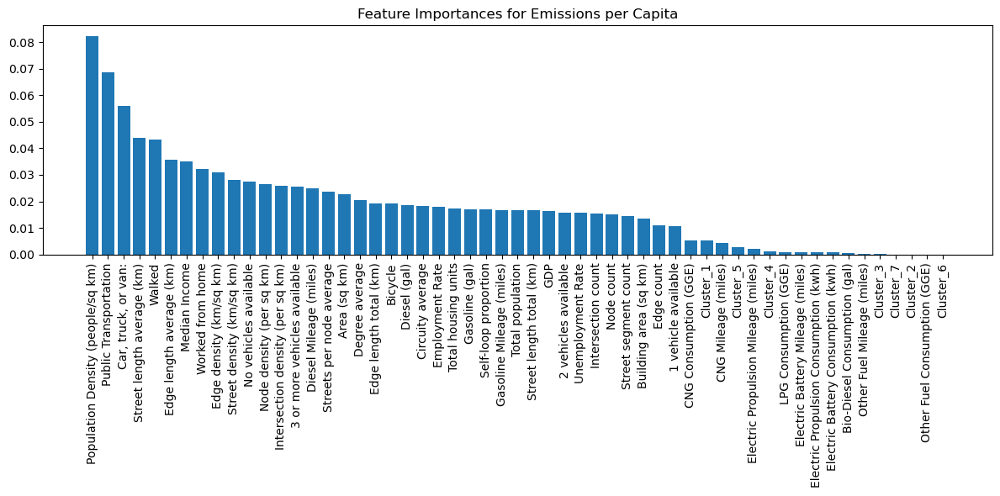

In [46]:
# Feature importance for emissions per capita
feature_importances_emissions_per_capita = best_rf_emissions_per_capita.feature_importances_
sorted_indices_emissions_per_capita = np.argsort(feature_importances_emissions_per_capita)[::-1]

print("Feature ranking for emissions per capita:")
for i in range(X.shape[1]):
    print(f"{i+1}. feature {sorted_indices_emissions_per_capita[i]} ({feature_importances_emissions_per_capita[sorted_indices_emissions_per_capita[i]]})")

# Plot feature importances for emissions per capita
plt.figure(figsize=(12, 6))
plt.title("Feature Importances for Emissions per Capita")
plt.bar(range(X.shape[1]), feature_importances_emissions_per_capita[sorted_indices_emissions_per_capita], align="center")
plt.xticks(range(X.shape[1]), X.columns[sorted_indices_emissions_per_capita], rotation=90)
plt.tight_layout()
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Scatter Plot of Actual vs. Predicted Emissions
plt.figure(figsize=(10, 6))
plt.scatter(y_test_emissions, y_pred_emissions, alpha=0.5)
plt.plot([min(y_test_emissions), max(y_test_emissions)], [min(y_test_emissions), max(y_test_emissions)], color='red', linestyle='--')  # Diagonal line
plt.xlabel('Actual Emissions (MMTCO$_2$e)',fontsize=20)
plt.ylabel('Predicted Emissions (MMTCO$_2$e)',fontsize=20)
plt.xticks(fontsize=15)  # Changed from plt.xtick to plt.xticks
plt.yticks(fontsize=15)  # Changed from plt.ytick to plt.yticks
#plt.title('Actual vs. Predicted Emissions')
plt.show()
#color each cluster type  for points 

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Scatter Plot of Actual vs. Predicted Emissions
plt.figure(figsize=(10, 6))
plt.scatter(y_test_emissions_per_capita, y_pred_emissions_per_capita, alpha=0.5)
plt.plot([min(y_test_emissions_per_capita), max(y_test_emissions_per_capita)], [min(y_test_emissions_per_capita), max(y_test_emissions_per_capita)], color='red', linestyle='--')  # Diagonal line
plt.xlabel('Actual Emissions (MMTCO$_2$e)',fontsize=20)
plt.ylabel('Predicted Emissions (MMTCO$_2$e)',fontsize=20)
plt.xticks(fontsize=15)  # Changed from plt.xtick to plt.xticks
plt.yticks(fontsize=15)  # Changed from plt.ytick to plt.yticks
#plt.title('Actual vs. Predicted Emissions')
plt.show()
#color each cluster type  for points 

In [ ]:
import matplotlib.pyplot as plt

# Scatter Plot of Actual vs. Predicted Emissions
plt.figure(figsize=(8, 4))
plt.scatter(y_test_emissions, y_pred_emissions, alpha=0.5)
plt.plot([min(y_test_emissions), max(y_test_emissions)], [min(y_test_emissions), max(y_test_emissions)], color='red', linestyle='--')  # Diagonal line
plt.xticks(fontsize=15)  # Changed from plt.xtick to plt.xticks
plt.yticks(fontsize=15)  # Changed from plt.ytick to plt.yticks

# Set the limits for the x and y axes to zoom in
plt.xlim(0, 6)  # Adjust these values as needed
plt.ylim(0, 6)  # Adjust these values as needed

plt.show()


In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes


# Main Plot
fig, ax = plt.subplots(figsize=(10, 6))
ax.scatter(y_test_emissions, y_pred_emissions, alpha=0.5)
ax.plot([min(y_test_emissions), max(y_test_emissions)], [min(y_test_emissions), max(y_test_emissions)], color='red', linestyle='--')  # Diagonal line
ax.set_xlabel('Actual Emissions (MMTCO$_2$e)', fontsize=20)
ax.set_ylabel('Predicted Emissions (MMTCO$_2$e)', fontsize=20)
ax.tick_params(axis='both', which='major', labelsize=15)

# Create inset of the main plot
inset_ax = inset_axes(ax, width='30%', height='30%', loc='upper left', bbox_to_anchor=(0.05, 0.001, 1, 1), bbox_transform=ax.transAxes)
inset_ax.scatter(y_test_emissions, y_pred_emissions, alpha=0.5)
inset_ax.plot([min(y_test_emissions), max(y_test_emissions)], [min(y_test_emissions), max(y_test_emissions)], color='red', linestyle='--')  # Diagonal line
inset_ax.set_xlim(0, 6)  # Adjust these values as needed
inset_ax.set_ylim(0, 6)  # Adjust these values as needed
inset_ax.tick_params(axis='both', which='major', labelsize=15)

plt.savefig('../../figures/actual-predicted-emissions.jpg', dpi=600)


In [ ]:
feature_importances_emissions

In [ ]:
# Calculate residuals
residuals_emissions = y_test_emissions- y_pred_emissions

# Residual Plot
fig, ax = plt.subplots(figsize=(10, 6))
plt.scatter(y_pred_emissions, residuals_emissions, alpha=0.5)
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted Emissions (MMTCO$_2$e)',fontsize=20)
plt.ylabel('Residuals',fontsize=20)
#plt.title('Residual Plot for Emissions')
plt.xticks(fontsize=15)  # Changed from plt.xtick to plt.xticks
plt.yticks(fontsize=15)  # Changed from plt.ytick to plt.yticks


plt.savefig('../../figures/residual-plot.jpg', dpi=600)


In [62]:
# Distribution of Residuals
plt.figure(figsize=(10, 6))
sns.histplot(residuals_emissions, kde=True)
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Distribution of Residuals for Emissions')
plt.show()


NameError: name 'residuals_emissions' is not defined

<Figure size 1000x600 with 0 Axes>

In [65]:

data.to_csv('../../results/cluster-msa.csv',index=False)
data

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,4
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,5
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,4
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,4
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,5
...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,1
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,1
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,5
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,4


In [48]:
divid_df=data.copy(deep=True)

# Extract city and state from MSA in df1
divid_df[['Area', 'State']] = divid_df['MSA'].str.split(', ', expand=True)
divid_df['Area'] = divid_df['Area'].str.split('-').str[0]

In [49]:
divid_df

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Area,State
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,4,Abilene,TX
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,5,Akron,OH
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,4,Albany,GA
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,4,Albany,OR
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,5,Albany,NY
...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,1,Yakima,WA
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,1,York,PA
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,5,Youngstown,OH-PA
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,4,Yuba City,CA


In [66]:

new_df.to_csv('../../results/cluster-msa-emissions.csv',index=False)
new_df

,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Total population,Emissions per capita,carbon dioxide equivalent (MMTCO2e),Emissions per capita (MTCO2e)
0,"Abilene, TX",1.604661e+06,0.064028,-0.090245,-0.400060,-0.559346,-0.116166,1.189935,-0.933108,Moderate Auto,171354,9.364594,1.455724,8.521780
1,"Akron, OH",4.038062e+06,-0.644944,-0.092501,0.164063,2.346351,-0.385593,0.417458,0.117013,Moderate Compact,703286,5.741707,3.663268,5.224953
2,"Albany, GA",1.062811e+06,-0.260352,0.017480,0.051700,-0.639637,-0.544648,0.891404,-0.652800,Moderate Auto,147431,7.208870,0.964166,6.560072
3,"Albany-Lebanon, OR",9.640033e+05,-0.245210,0.049604,0.265477,-1.116083,-0.324938,-0.909080,-1.168184,Moderate Auto,127216,7.577689,0.874529,6.895697
4,"Albany-Schenectady-Troy, NY",4.416599e+06,0.192923,-0.144945,-0.251121,0.409409,0.719031,0.376100,0.017240,Moderate Compact,880766,5.014498,4.006672,4.563193
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350,"Yakima, WA",1.345779e+06,0.028180,0.015642,0.263209,-1.323508,-0.913108,0.023896,-1.262105,Small Compact,250649,5.369176,1.220870,4.885950
351,"York-Hanover, PA",2.087107e+06,-0.667277,-0.056662,0.188996,1.740468,-0.612997,0.558831,-0.484439,Small Compact,447628,4.662592,1.893391,4.242959
352,"Youngstown-Warren-Boardman, OH-PA",3.089513e+06,-0.138366,-0.086734,-0.145649,0.828986,-0.601778,0.650931,-0.057509,Moderate Compact,538115,5.741362,2.802759,5.224640
353,"Yuba City, CA",5.800871e+05,-0.413179,0.043812,0.134645,-0.453808,-0.491657,-0.147507,-0.227548,Moderate Auto,173839,3.336922,0.526246,3.036599


In [51]:
# Replace 'your_shapefile_path' with the path to your shapefile
gdf = gpd.read_file('../../data/raw/cb_2018_us_cbsa_500k/cb_2018_us_cbsa_500k.shp')
us_state = gpd.read_file('../../data/raw/cb_2018_us_state_500k/cb_2018_us_state_500k.shp')
# Filter for Metropolitan Statistical Areas (MSA)
msa_gdf = gdf[(gdf['CBSAFP'].notnull()) & (gdf['LSAD'] == 'M1')]

# Extract city and state from NAME in df2
msa_gdf[['Area', 'State']] = msa_gdf['NAME'].str.split(', ', expand=True)
msa_gdf['Area'] = msa_gdf['Area'].str.split('-').str[0]
msa_gdf

C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
C:\Users\peiyaozhao\AppData\Local\anaconda3\Lib\site-packages\geopandas\geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,State
0,None,31340,310M400US31340,31340,"Lynchburg, VA",M1,5491925729,68559452,"POLYGON ((-79.85840 37.26715, -79.85660 37.268...",Lynchburg,VA
1,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,CA
3,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,OK
5,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,CA
8,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,AR
...,...,...,...,...,...,...,...,...,...,...,...
934,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,CA
936,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,AZ
938,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,AL
939,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,CT


In [52]:
if isinstance(divid_df.columns, pd.MultiIndex):
    divid_df.columns = divid_df.columns.get_level_values(0)
if isinstance(msa_gdf.columns, pd.MultiIndex):
    msa_gdf.columns = msa_gdf.columns.get_level_values(0)

# Merge the dataframes on the 'Area' and 'State' columns
merged_df = msa_gdf.merge(divid_df, on=['Area', 'State'], suffixes=('_pivot', '_msa'))
merged_df

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,MSA,carbon dioxide equivalent (Ton),Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster
0,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,...,"Santa Rosa-Petaluma, CA",2.130224e+06,-0.442451,-0.004047,0.165429,-0.358180,0.834247,-1.175155,0.975784,1
1,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,...,"Tulsa, OK",6.939685e+06,1.523463,-0.389664,-1.165643,-0.350318,-0.678919,-0.012653,0.472247,5
2,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,...,"San Diego-Chula Vista-Carlsbad, CA",1.673588e+07,0.215365,0.104024,2.780266,-0.174438,0.963534,-0.874193,0.964914,7
3,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,...,"Pine Bluff, AR",7.791471e+05,-0.088948,0.024617,-0.027455,-0.507161,-1.457494,-0.622676,-0.781182,4
4,None,17020,310M400US17020,17020,"Chico, CA",M1,4238438186,105311003,"POLYGON ((-122.06874 39.84222, -122.06694 39.8...",Chico,...,"Chico, CA",1.182906e+06,-0.405165,0.001967,-0.101584,-0.299432,0.715881,-1.475741,-0.156537,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
347,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,...,"San Luis Obispo-Paso Robles, CA",1.256077e+06,-0.254141,-0.015640,-0.101944,-1.227329,1.392291,-0.725550,0.342979,1
348,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,...,"Yuma, AZ",1.288764e+06,-0.136282,0.063852,0.165466,-1.878342,-0.400073,0.916167,0.678052,1
349,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,...,"Dothan, AL",1.124121e+06,-0.131854,-0.002914,-0.086716,-0.290945,-1.414871,0.612840,-0.268163,4
350,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,...,"Bridgeport-Stamford-Norwalk, CT",4.288006e+06,-1.126498,-0.182895,0.072732,4.050455,2.274730,-0.387779,-0.961063,5


In [53]:
merged_df['Emissions per capita']=new_df['Emissions per capita (MTCO2e)']

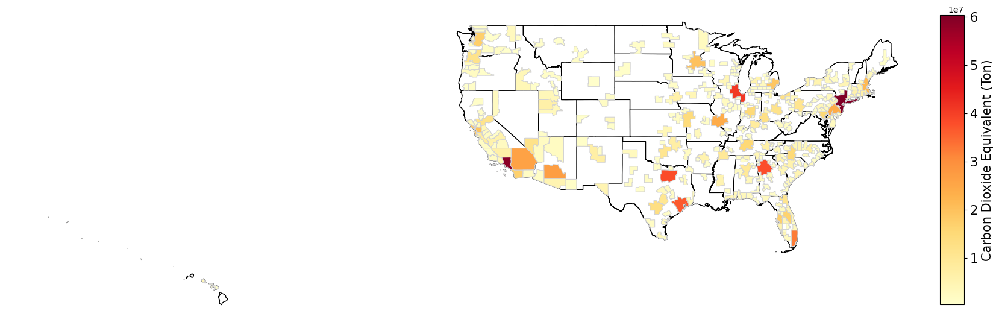

In [54]:
import matplotlib.pyplot as plt
import geopandas as gpd
import seaborn as sns

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

# Calculate the bounding box that covers both DataFrames
minx, miny, maxx, maxy = merged_df.total_bounds
us_state = us_state.cx[minx:maxx, miny:maxy]

# Plot the heatmap with town boundaries
fig, ax = plt.subplots(1, 1, figsize=(20, 12))
ax.set_axis_off()
us_state.plot(ax=ax, color='white', edgecolor='black')  # Plot town boundaries

# Plot the heatmap with adjusted boundary color
merged_df.plot(column='carbon dioxide equivalent (Ton)', cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='lightgray')  # Plot heatmap

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.3, 0.02, 0.4])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['carbon dioxide equivalent (Ton)'].min(), vmax=merged_df['carbon dioxide equivalent (Ton)'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)

# Add unit label to the colorbar
colorbar.set_label('Carbon Dioxide Equivalent (Ton)', size=15)

colorbar.ax.tick_params(labelsize=15)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/carbondioxide-heatmap.png', dpi=360)



In [55]:
merged_df.columns

Index(['CSAFP', 'CBSAFP', 'AFFGEOID', 'GEOID', 'NAME', 'LSAD', 'ALAND',
       'AWATER', 'geometry', 'Area', 'State', 'MSA',
       'carbon dioxide equivalent (Ton)', 'Size--Auto',
       'Public Transportation', 'Transit Alternative Fuel', 'Density',
       'Active Mobility', 'Network Connectivity', 'Network Compactness',
       'Cluster', 'Emissions per capita'],
      dtype='object')

In [56]:
merged_df['greenhouse gas emissions (MMTCO2e)']=merged_df['carbon dioxide equivalent (Ton)']/1102311.31

In [57]:
merged_df

,CSAFP,CBSAFP,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,Area,...,Size--Auto,Public Transportation,Transit Alternative Fuel,Density,Active Mobility,Network Connectivity,Network Compactness,Cluster,Emissions per capita,greenhouse gas emissions (MMTCO2e)
0,488,42220,310M400US42220,42220,"Santa Rosa, CA",M1,4081491107,497455304,"POLYGON ((-123.53354 38.76841, -123.52851 38.7...",Santa Rosa,...,-0.442451,-0.004047,0.165429,-0.358180,0.834247,-1.175155,0.975784,1,8.521780,1.932506
1,538,46140,310M400US46140,46140,"Tulsa, OK",M1,16238554204,492994165,"POLYGON ((-97.06448 36.68106, -97.06411 36.684...",Tulsa,...,1.523463,-0.389664,-1.165643,-0.350318,-0.678919,-0.012653,0.472247,5,5.224953,6.295576
2,None,41740,310M400US41740,41740,"San Diego-Carlsbad, CA",M1,10900649391,820695499,"POLYGON ((-117.59615 33.38717, -117.59360 33.3...",San Diego,...,0.215365,0.104024,2.780266,-0.174438,0.963534,-0.874193,0.964914,7,6.560072,15.182534
3,340,38220,310M400US38220,38220,"Pine Bluff, AR",M1,5255934204,143446207,"POLYGON ((-92.47391 34.00623, -92.47241 34.038...",Pine Bluff,...,-0.088948,0.024617,-0.027455,-0.507161,-1.457494,-0.622676,-0.781182,4,6.895697,0.706830
4,None,17020,310M400US17020,17020,"Chico, CA",M1,4238438186,105311003,"POLYGON ((-122.06874 39.84222, -122.06694 39.8...",Chico,...,-0.405165,0.001967,-0.101584,-0.299432,0.715881,-1.475741,-0.156537,4,4.563193,1.073115
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
347,None,42020,310M400US42020,42020,"San Luis Obispo-Paso Robles-Arroyo Grande, CA",M1,8548611925,815519172,"POLYGON ((-121.34636 35.79518, -121.24378 35.7...",San Luis Obispo,...,-0.254141,-0.015640,-0.101944,-1.227329,1.392291,-0.725550,0.342979,1,4.611721,1.139494
348,None,49740,310M400US49740,49740,"Yuma, AZ",M1,14281127830,13326079,"POLYGON ((-114.81629 32.50804, -114.81432 32.5...",Yuma,...,-0.136282,0.063852,0.165466,-1.878342,-0.400073,0.916167,0.678052,1,5.512735,1.169147
349,222,20020,310M400US20020,20020,"Dothan, AL",M1,4444678880,33248036,"POLYGON ((-86.19348 31.19221, -86.14167 31.192...",Dothan,...,-0.131854,-0.002914,-0.086716,-0.290945,-1.414871,0.612840,-0.268163,4,4.528186,1.019785
350,408,14860,310M400US14860,14860,"Bridgeport-Stamford-Norwalk, CT",M1,1618651428,549293518,"MULTIPOLYGON (((-73.21717 41.14391, -73.21611 ...",Bridgeport,...,-1.126498,-0.182895,0.072732,4.050455,2.274730,-0.387779,-0.961063,5,4.885950,3.890013


In [58]:
# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(30, 20), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='greenhouse gas emissions (MMTCO2e)', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(20, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.2, 0.18, 0.6, 0.04])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['greenhouse gas emissions (MMTCO2e)'].min(), vmax=merged_df['greenhouse gas emissions (MMTCO2e)'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax, orientation='horizontal')

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Emissions (MMTCO$_{2}$e)', size=30)

colorbar.ax.tick_params(labelsize=20)

# Adjust layout to minimize white space
plt.tight_layout()

# Optionally, adjust subplot parameters to further reduce white space
fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/greenhousegas-heatmap.jpg', dpi=600)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11428\3969700091.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


In [59]:
# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(30, 20), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']

us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='Emissions per capita', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(20, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.2, 0.18, 0.6, 0.04])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['Emissions per capita'].min(), vmax=merged_df['Emissions per capita'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax, orientation='horizontal')

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Per-capita Emissions (MTCO$_{2}$e)', size=30)

colorbar.ax.tick_params(labelsize=20)

# Adjust layout to minimize white space
plt.tight_layout()

# Optionally, adjust subplot parameters to further reduce white space
fig.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.05)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/greenhousegas-per-capita-heatmap.jpg', dpi=600)

C:\Users\peiyaozhao\AppData\Local\Temp\ipykernel_11428\2773226980.py:45: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


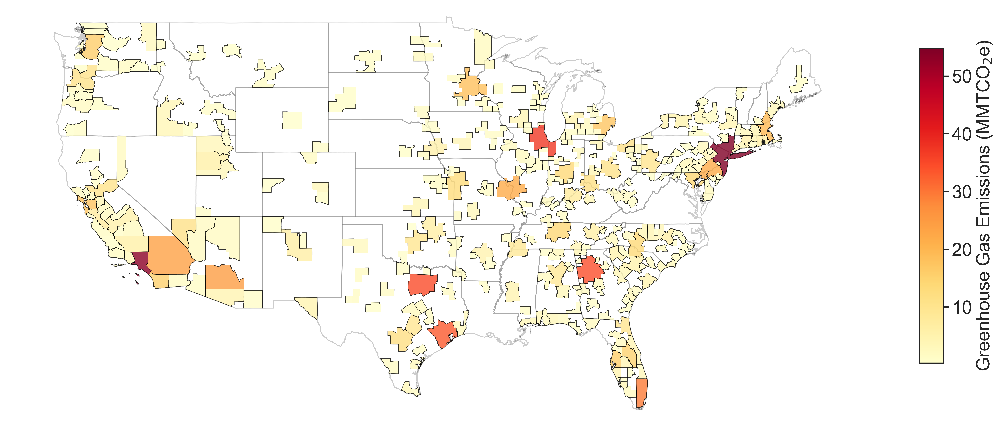

In [60]:
# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(18, 8), dpi=600)

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Filter out Alaska
us_state = us_state[us_state['NAME'] != 'Alaska']




us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the heatmap with adjusted boundary color
merged_df.plot(ax=ax, alpha=0.8, column='greenhouse gas emissions (MMTCO2e)', cmap='YlOrRd', legend=False, edgecolor='black', linewidth=0.5)

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(25, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.2, 0.02, 0.6])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['greenhouse gas emissions (MMTCO2e)'].min(), vmax=merged_df['greenhouse gas emissions (MMTCO2e)'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)

# Add unit label to the colorbar
colorbar.set_label('Greenhouse Gas Emissions (MMTCO$_{2}$e)', size=20)

colorbar.ax.tick_params(labelsize=20)

#ax.set_title('Carbon Dioxide Equivalent Heatmap with MSA Boundaries', fontsize=20)

plt.savefig('../../figures/greenhousegas-heatmap.jpg', dpi=600)

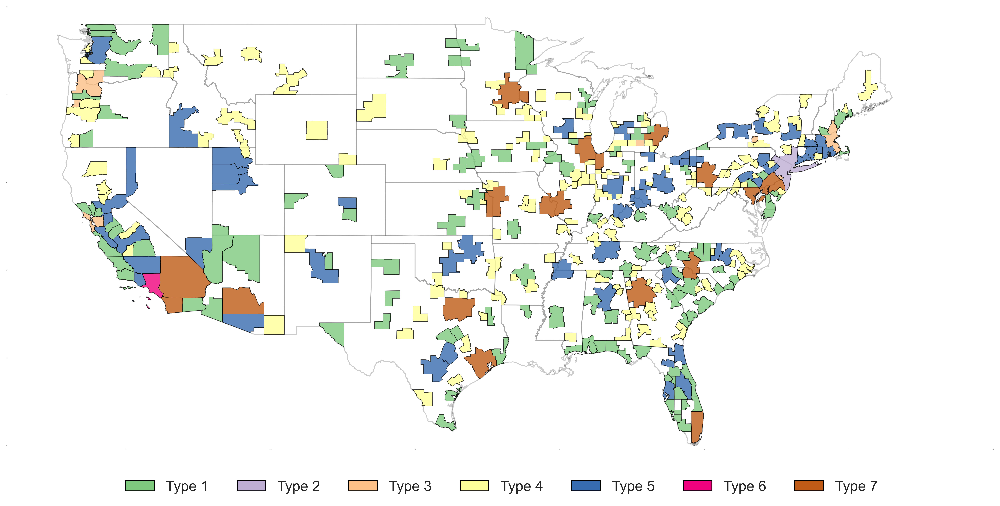

In [61]:
# Set the theme
sns.set_theme(style="white")

# Create the figure and axis
fig, ax = plt.subplots(figsize=(18, 8), dpi=600)

# Load shapefile (assuming us_state and merged_df are your data)
# us_state = gpd.read_file('path_to_us_state_shapefile.shp')
# merged_df = gpd.read_file('path_to_merged_shapefile.shp')

# Define the custom color palette
custom_palette = ['#7fc97f', '#beaed4', '#fdc086', '#ffff99', '#386cb0', '#f0027f', '#bf5b17']
color_iter_cmap = ListedColormap(custom_palette)

# Plot the base map
us_state.plot(ax=ax, alpha=0.2, facecolor='white', edgecolor='black')

# Plot the merged DataFrame with the 'Cluster' column
merged_df.plot(ax=ax, alpha=0.8, column='Cluster', cmap=color_iter_cmap, legend=False, edgecolor='black', linewidth=0.5)

# Customize the plot
plt.xlabel('')
plt.ylabel('')
plt.title('')
plt.xlim(-128, -60)
plt.ylim(25, 50)
plt.grid(False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.tick_params(axis='both', which='both', length=0)
plt.tick_params(axis='both', which='both', labelsize=0)

# Create custom legend
cluster_labels = [f'Type {i}' for i in range(1, 8)]
legend_elements = [Patch(facecolor=color_iter_cmap(i), edgecolor='black', label=label) for i, label in enumerate(cluster_labels)]

# Place the legend horizontally below the plot
leg = ax.legend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=7, frameon=False, fontsize=16)

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig('../../figures/typemap.jpg', dpi=600)

In [ ]:
us_state = us_state[us_state['NAME'] != 'Alaska']

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Calculate the bounding box that covers both dataframes
minx, miny, maxx, maxy = merged_df.total_bounds
us_state = us_state.cx[minx:maxx, miny:maxy]

# Plot the heatmap with town boundaries
fig, ax = plt.subplots(1, 1, figsize=(20, 12))
ax.set_axis_off()
us_state.plot(ax=ax, color='white', edgecolor='black')  # Plot town boundaries

# Plot the heatmap with adjusted boundary color
merged_df.plot(column='Urban Size', cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='lightgray')  # Plot heatmap

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.3, 0.02, 0.4])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['Urban Size'].min(), vmax=merged_df['Urban Size'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)
colorbar.ax.tick_params(labelsize=15)

ax.set_title('Urban Size Heatmap with MSA Boundaries', fontsize=20)

In [ ]:
us_state = us_state[us_state['NAME'] != 'Alaska']

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Calculate the bounding box that covers both dataframes
minx, miny, maxx, maxy = merged_df.total_bounds
us_state = us_state.cx[minx:maxx, miny:maxy]

# Plot the heatmap with town boundaries
fig, ax = plt.subplots(1, 1, figsize=(20, 12))
ax.set_axis_off()
us_state.plot(ax=ax, color='white', edgecolor='black')  # Plot town boundaries

# Plot the heatmap with adjusted boundary color
merged_df.plot(column='Public Transportation', cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='lightgray')  # Plot heatmap

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.3, 0.02, 0.4])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['Public Transportation'].min(), vmax=merged_df['Public Transportation'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)
colorbar.ax.tick_params(labelsize=15)

ax.set_title('Public Transportation Heatmap with MSA Boundaries', fontsize=20)

In [ ]:
us_state = us_state[us_state['NAME'] != 'Alaska']

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Calculate the bounding box that covers both dataframes
minx, miny, maxx, maxy = merged_df.total_bounds
us_state = us_state.cx[minx:maxx, miny:maxy]

# Plot the heatmap with town boundaries
fig, ax = plt.subplots(1, 1, figsize=(20, 12))
ax.set_axis_off()
us_state.plot(ax=ax, color='white', edgecolor='black')  # Plot town boundaries

# Plot the heatmap with adjusted boundary color
merged_df.plot(column='Transit Alternative Fuel', cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='lightgray')  # Plot heatmap

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.3, 0.02, 0.4])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['Transit Alternative Fuel'].min(), vmax=merged_df['Transit Alternative Fuel'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)
colorbar.ax.tick_params(labelsize=15)

ax.set_title('Transit Alternative Fuel Heatmap with MSA Boundaries', fontsize=20)

In [ ]:
us_state = us_state[us_state['NAME'] != 'Alaska']

# Ensure both DataFrames use the same CRS
us_state = us_state.to_crs(epsg=4326)
merged_df = merged_df.to_crs(epsg=4326)

# Calculate the bounding box that covers both dataframes
minx, miny, maxx, maxy = merged_df.total_bounds
us_state = us_state.cx[minx:maxx, miny:maxy]

# Plot the heatmap with town boundaries
fig, ax = plt.subplots(1, 1, figsize=(20, 12))
ax.set_axis_off()
us_state.plot(ax=ax, color='white', edgecolor='black')  # Plot town boundaries

# Plot the heatmap with adjusted boundary color
merged_df.plot(column='Active Mobility', cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='lightgray')  # Plot heatmap

# Add colorbar with a smaller size
cax = fig.add_axes([0.9, 0.3, 0.02, 0.4])
sm = plt.cm.ScalarMappable(cmap='YlOrRd', norm=plt.Normalize(vmin=merged_df['Active Mobility'].min(), vmax=merged_df['Active Mobility'].max()))
sm._A = []
colorbar = fig.colorbar(sm, cax=cax)
colorbar.ax.tick_params(labelsize=15)

ax.set_title('Active Mobility Heatmap with MSA Boundaries', fontsize=20)